In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
os.getcwd()

'/content'

In [3]:
os.chdir('drive/MyDrive/Colab Notebooks/wind_energy_production_forecast/')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/wind_energy_production_forecast'

## Import for data exloration

In [4]:
# przetwarzanie  
import numpy as np
import pandas as pd

import datetime

# wizualizacja   
import matplotlib.pyplot as plt
import seaborn as sns


## Data Download

In [5]:
windfarm = pd.read_csv('list_of_windfarm.csv')
windfarm

,id,power,estimated production per year,weather station,first coordinate,second coordinate,distancefrom the station
0,W3a,1.50,1500,S3,-0.517309,0.633981,0.818255
1,W3b,1.00,1000,S3,-0.581086,0.580504,0.821368
2,W5,0.90,600,S3,-0.314812,0.450098,0.549268
3,W9a,0.85,1500,S1,-0.035399,0.793434,0.794223
4,W9c,0.85,1500,S1,-0.132674,0.723633,0.735695
5,W9d,5.95,10000,S3,-0.355935,0.255343,0.438052
6,W13,1.00,1400,S1,0.631144,-0.318059,0.706756
7,W14,1.00,2000,S1,0.840543,-0.254048,0.878096
8,W15,4.95,6200,S3,-0.016795,-0.386608,0.386973
9,W19,1.50,1500,S6,0.710579,0.829321,1.092106


In [6]:
windfarm.rename(columns = {'id':'wind_turbine'}, inplace = True)
windfarm

,wind_turbine,power,estimated production per year,weather station,first coordinate,second coordinate,distancefrom the station
0,W3a,1.50,1500,S3,-0.517309,0.633981,0.818255
1,W3b,1.00,1000,S3,-0.581086,0.580504,0.821368
2,W5,0.90,600,S3,-0.314812,0.450098,0.549268
3,W9a,0.85,1500,S1,-0.035399,0.793434,0.794223
4,W9c,0.85,1500,S1,-0.132674,0.723633,0.735695
5,W9d,5.95,10000,S3,-0.355935,0.255343,0.438052
6,W13,1.00,1400,S1,0.631144,-0.318059,0.706756
7,W14,1.00,2000,S1,0.840543,-0.254048,0.878096
8,W15,4.95,6200,S3,-0.016795,-0.386608,0.386973
9,W19,1.50,1500,S6,0.710579,0.829321,1.092106


In [7]:
windfarm.columns

Index(['wind_turbine', 'power', 'estimated production per year',
       'weather station', 'first coordinate', 'second coordinate',
       'distancefrom the station'],
      dtype='object')

In [127]:
s1_forecast = pd.read_csv('S1.csv')
s1_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition
0,2022-01-01,1,34.0,34.0,100.0,WNW,13.0,0.0,"29,27",0.0,Cloudy
1,2022-01-01,2,52.0,50.0,94.0,W,14.0,0.0,"29,59",0.0,Light Rain
2,2022-01-01,3,52.0,50.0,94.0,W,15.0,0.0,"29,62",0.0,Light Rain
3,2022-01-01,4,52.0,50.0,94.0,W,13.0,0.0,"29,62",0.0,Light Rain
4,2022-01-01,5,52.0,50.0,94.0,WNW,13.0,0.0,"29,65",0.0,Light Rain


In [128]:
s1_forecast['weather_station'] = 'S1'
s1_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition,weather_station
0,2022-01-01,1,34.0,34.0,100.0,WNW,13.0,0.0,"29,27",0.0,Cloudy,S1
1,2022-01-01,2,52.0,50.0,94.0,W,14.0,0.0,"29,59",0.0,Light Rain,S1
2,2022-01-01,3,52.0,50.0,94.0,W,15.0,0.0,"29,62",0.0,Light Rain,S1
3,2022-01-01,4,52.0,50.0,94.0,W,13.0,0.0,"29,62",0.0,Light Rain,S1
4,2022-01-01,5,52.0,50.0,94.0,WNW,13.0,0.0,"29,65",0.0,Light Rain,S1


In [129]:
s3_forecast = pd.read_csv('S3.csv')
s3_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition
0,2022-01-01,1,52.0,50.0,94.0,W,14.0,0.0,"29,57",0.0,Light Rain
1,2022-01-01,2,50.0,48.0,94.0,NW,9.0,0.0,"29,60",0.0,Light Rain
2,2022-01-01,3,50.0,48.0,94.0,NW,12.0,0.0,"29,60",0.0,Mostly Cloudy
3,2022-01-01,4,48.0,46.0,93.0,NW,13.0,0.0,"29,63",0.0,Mostly Cloudy
4,2022-01-01,5,48.0,46.0,93.0,WNW,10.0,0.0,"29,66",0.0,Cloudy


In [130]:
s3_forecast['weather_station'] = 'S3'
s3_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition,weather_station
0,2022-01-01,1,52.0,50.0,94.0,W,14.0,0.0,"29,57",0.0,Light Rain,S3
1,2022-01-01,2,50.0,48.0,94.0,NW,9.0,0.0,"29,60",0.0,Light Rain,S3
2,2022-01-01,3,50.0,48.0,94.0,NW,12.0,0.0,"29,60",0.0,Mostly Cloudy,S3
3,2022-01-01,4,48.0,46.0,93.0,NW,13.0,0.0,"29,63",0.0,Mostly Cloudy,S3
4,2022-01-01,5,48.0,46.0,93.0,WNW,10.0,0.0,"29,66",0.0,Cloudy,S3


In [131]:
s6_forecast = pd.read_csv('S6.csv')
s6_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition
0,2022-01-01,1,48.0,46.0,93.0,WSW,13.0,0.0,"28,91",0.0,Light Rain
1,2022-01-01,2,48.0,46.0,93.0,W,14.0,0.0,"28,91",0.0,Light Rain
2,2022-01-01,3,48.0,46.0,93.0,W,14.0,0.0,"28,91",0.0,Light Rain
3,2022-01-01,4,48.0,48.0,100.0,W,14.0,0.0,"28,91",0.0,Light Rain
4,2022-01-01,5,50.0,48.0,94.0,W,14.0,0.0,"28,94",0.0,Rain


In [132]:
s6_forecast['weather_station'] = 'S6'
s6_forecast.head()

,Date,Time,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,"Precip,",Condition,weather_station
0,2022-01-01,1,48.0,46.0,93.0,WSW,13.0,0.0,"28,91",0.0,Light Rain,S6
1,2022-01-01,2,48.0,46.0,93.0,W,14.0,0.0,"28,91",0.0,Light Rain,S6
2,2022-01-01,3,48.0,46.0,93.0,W,14.0,0.0,"28,91",0.0,Light Rain,S6
3,2022-01-01,4,48.0,48.0,100.0,W,14.0,0.0,"28,91",0.0,Light Rain,S6
4,2022-01-01,5,50.0,48.0,94.0,W,14.0,0.0,"28,94",0.0,Rain,S6


In [14]:
s6_forecast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2160 entries, 0 to 2159
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Date             2160 non-null   object 
 1   Time             2160 non-null   int64  
 2   Temperature      2125 non-null   float64
 3   Dew Point        2125 non-null   float64
 4   Humidity         2125 non-null   float64
 5   Wind             2125 non-null   object 
 6   Wind Speed       2125 non-null   float64
 7   Wind Gust        2125 non-null   float64
 8   Pressure         2125 non-null   object 
 9   Precip,          2125 non-null   float64
 10  Condition        2125 non-null   object 
 11  weather_station  2160 non-null   object 
dtypes: float64(6), int64(1), object(5)
memory usage: 202.6+ KB


In [15]:
list_of_windfarm = []
for i in range(0,15):
  new = windfarm['wind_turbine'][i]
  list_of_windfarm.append(new)

list_of_windfarm

['W3a',
 'W3b',
 'W5',
 'W9a',
 'W9c',
 'W9d',
 'W13',
 'W14',
 'W15',
 'W19',
 'W20',
 'W21',
 'W24',
 'W28',
 'W29']

In [133]:
w3a_df = pd.read_csv('W3a.csv')
w3a_df.sample(5)

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition
1942,2022-03-22 23:00:00,92.52,36.0,21.0,56.0,VAR,1.0,0.0,30.27,0.0,Fair
1020,2022-02-12 13:00:00,122.40,36.0,28.0,75.0,WSW,12.0,0.0,30.24,0.0,Fair
944,2022-02-09 09:00:00,553.32,39.0,37.0,93.0,SW,10.0,0.0,29.86,0.0,Cloudy
811,2022-02-03 20:00:00,100.44,36.0,34.0,93.0,SSE,6.0,0.0,29.66,0.0,Fair
1077,2022-02-14 22:00:00,454.50,39.0,27.0,61.0,S,12.0,0.0,29.51,0.0,Fair


In [17]:
w3a_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Humidity',
       'Wind', 'Wind Speed', 'Wind Gust', 'Pressure', 'Precipitation',
       'Condition'],
      dtype='object')

In [18]:
wind_df = pd.DataFrame(columns=['Date', 'Energy production', 'Temperature', 'Dew Point', 'Humidity',
       'Wind', 'Wind Speed', 'Wind Gust', 'Pressure', 'Precipitation', 'Condition'])
for i in range(0,len(list_of_windfarm)):

  new = pd.read_csv(list_of_windfarm[i]+'.csv')
  new['wind_turbine'] = list_of_windfarm[i]
  wind_df = pd.concat([wind_df, new])

wind_df

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition,wind_turbine
0,2022-01-01 01:00:00,836.10,52.0,50.0,94.0,W,14.0,0.0,29.57,0.0,Light Rain,W3a
1,2022-01-01 02:00:00,510.30,50.0,48.0,94.0,NW,9.0,0.0,29.60,0.0,Light Rain,W3a
2,2022-01-01 03:00:00,622.80,50.0,48.0,94.0,NW,12.0,0.0,29.60,0.0,Mostly Cloudy,W3a
3,2022-01-01 04:00:00,475.74,48.0,46.0,93.0,NW,13.0,0.0,29.63,0.0,Mostly Cloudy,W3a
4,2022-01-01 05:00:00,421.38,48.0,46.0,93.0,WNW,10.0,0.0,29.66,0.0,Cloudy,W3a
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2022-03-31 20:00:00,265.95,39.0,9.0,28.0,NE,16.0,0.0,29.45,0.0,Fair,W29
2155,2022-03-31 21:00:00,289.44,37.0,9.0,30.0,NE,15.0,0.0,29.45,0.0,Fair,W29
2156,2022-03-31 22:00:00,266.76,37.0,9.0,30.0,NE,12.0,0.0,29.48,0.0,Fair,W29
2157,2022-03-31 23:00:00,241.29,36.0,10.0,35.0,NE,15.0,0.0,29.48,0.0,Fair,W29


In [19]:
wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32385 entries, 0 to 2158
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Date               32385 non-null  object 
 1   Energy production  32385 non-null  float64
 2   Temperature        31968 non-null  float64
 3   Dew Point          31968 non-null  float64
 4   Humidity           31968 non-null  float64
 5   Wind               31968 non-null  object 
 6   Wind Speed         31968 non-null  float64
 7   Wind Gust          31968 non-null  float64
 8   Pressure           31968 non-null  float64
 9   Precipitation      31968 non-null  float64
 10  Condition          31968 non-null  object 
 11  wind_turbine       32385 non-null  object 
dtypes: float64(8), object(4)
memory usage: 3.2+ MB


In [20]:
wind_df['Date'] =  pd.to_datetime(wind_df['Date'], format='%Y-%m-%d %H:%M:%S')

In [21]:
wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32385 entries, 0 to 2158
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Date               32385 non-null  datetime64[ns]
 1   Energy production  32385 non-null  float64       
 2   Temperature        31968 non-null  float64       
 3   Dew Point          31968 non-null  float64       
 4   Humidity           31968 non-null  float64       
 5   Wind               31968 non-null  object        
 6   Wind Speed         31968 non-null  float64       
 7   Wind Gust          31968 non-null  float64       
 8   Pressure           31968 non-null  float64       
 9   Precipitation      31968 non-null  float64       
 10  Condition          31968 non-null  object        
 11  wind_turbine       32385 non-null  object        
dtypes: datetime64[ns](1), float64(8), object(3)
memory usage: 3.2+ MB


In [22]:
wind_df

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition,wind_turbine
0,2022-01-01 01:00:00,836.10,52.0,50.0,94.0,W,14.0,0.0,29.57,0.0,Light Rain,W3a
1,2022-01-01 02:00:00,510.30,50.0,48.0,94.0,NW,9.0,0.0,29.60,0.0,Light Rain,W3a
2,2022-01-01 03:00:00,622.80,50.0,48.0,94.0,NW,12.0,0.0,29.60,0.0,Mostly Cloudy,W3a
3,2022-01-01 04:00:00,475.74,48.0,46.0,93.0,NW,13.0,0.0,29.63,0.0,Mostly Cloudy,W3a
4,2022-01-01 05:00:00,421.38,48.0,46.0,93.0,WNW,10.0,0.0,29.66,0.0,Cloudy,W3a
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2022-03-31 20:00:00,265.95,39.0,9.0,28.0,NE,16.0,0.0,29.45,0.0,Fair,W29
2155,2022-03-31 21:00:00,289.44,37.0,9.0,30.0,NE,15.0,0.0,29.45,0.0,Fair,W29
2156,2022-03-31 22:00:00,266.76,37.0,9.0,30.0,NE,12.0,0.0,29.48,0.0,Fair,W29
2157,2022-03-31 23:00:00,241.29,36.0,10.0,35.0,NE,15.0,0.0,29.48,0.0,Fair,W29


In [23]:
windfarm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15 entries, 0 to 14
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   wind_turbine                   15 non-null     object 
 1   power                          15 non-null     float64
 2   estimated production per year  15 non-null     int64  
 3   weather station                15 non-null     object 
 4   first coordinate               15 non-null     float64
 5   second coordinate              15 non-null     float64
 6   distancefrom the station       15 non-null     float64
dtypes: float64(4), int64(1), object(2)
memory usage: 968.0+ bytes


In [25]:
full_wind_df = pd.merge(wind_df, windfarm, on="wind_turbine")

In [26]:
full_wind_df

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition,wind_turbine,power,estimated production per year,weather station,first coordinate,second coordinate,distancefrom the station
0,2022-01-01 01:00:00,836.10,52.0,50.0,94.0,W,14.0,0.0,29.57,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
1,2022-01-01 02:00:00,510.30,50.0,48.0,94.0,NW,9.0,0.0,29.60,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
2,2022-01-01 03:00:00,622.80,50.0,48.0,94.0,NW,12.0,0.0,29.60,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
3,2022-01-01 04:00:00,475.74,48.0,46.0,93.0,NW,13.0,0.0,29.63,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
4,2022-01-01 05:00:00,421.38,48.0,46.0,93.0,WNW,10.0,0.0,29.66,0.0,Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32380,2022-03-31 20:00:00,265.95,39.0,9.0,28.0,NE,16.0,0.0,29.45,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
32381,2022-03-31 21:00:00,289.44,37.0,9.0,30.0,NE,15.0,0.0,29.45,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
32382,2022-03-31 22:00:00,266.76,37.0,9.0,30.0,NE,12.0,0.0,29.48,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
32383,2022-03-31 23:00:00,241.29,36.0,10.0,35.0,NE,15.0,0.0,29.48,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352


In [27]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32385 entries, 0 to 32384
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   Date                           32385 non-null  datetime64[ns]
 1   Energy production              32385 non-null  float64       
 2   Temperature                    31968 non-null  float64       
 3   Dew Point                      31968 non-null  float64       
 4   Humidity                       31968 non-null  float64       
 5   Wind                           31968 non-null  object        
 6   Wind Speed                     31968 non-null  float64       
 7   Wind Gust                      31968 non-null  float64       
 8   Pressure                       31968 non-null  float64       
 9   Precipitation                  31968 non-null  float64       
 10  Condition                      31968 non-null  object        
 11  wind_turbine   

We have missing weather data for several items.
As we want to investigate the effect of the weather on the volume of generated energy, we will delete these items in order not to pollute the data

In [28]:
full_wind_df = full_wind_df.dropna(how='any',axis=0) 

In [29]:
full_wind_df.reset_index(drop=True)

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition,wind_turbine,power,estimated production per year,weather station,first coordinate,second coordinate,distancefrom the station
0,2022-01-01 01:00:00,836.10,52.0,50.0,94.0,W,14.0,0.0,29.57,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
1,2022-01-01 02:00:00,510.30,50.0,48.0,94.0,NW,9.0,0.0,29.60,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
2,2022-01-01 03:00:00,622.80,50.0,48.0,94.0,NW,12.0,0.0,29.60,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
3,2022-01-01 04:00:00,475.74,48.0,46.0,93.0,NW,13.0,0.0,29.63,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
4,2022-01-01 05:00:00,421.38,48.0,46.0,93.0,WNW,10.0,0.0,29.66,0.0,Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31963,2022-03-31 20:00:00,265.95,39.0,9.0,28.0,NE,16.0,0.0,29.45,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
31964,2022-03-31 21:00:00,289.44,37.0,9.0,30.0,NE,15.0,0.0,29.45,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
31965,2022-03-31 22:00:00,266.76,37.0,9.0,30.0,NE,12.0,0.0,29.48,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352
31966,2022-03-31 23:00:00,241.29,36.0,10.0,35.0,NE,15.0,0.0,29.48,0.0,Fair,W29,0.5,800,S3,-0.249384,-0.116731,0.275352


In [30]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31968 entries, 0 to 32384
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   Date                           31968 non-null  datetime64[ns]
 1   Energy production              31968 non-null  float64       
 2   Temperature                    31968 non-null  float64       
 3   Dew Point                      31968 non-null  float64       
 4   Humidity                       31968 non-null  float64       
 5   Wind                           31968 non-null  object        
 6   Wind Speed                     31968 non-null  float64       
 7   Wind Gust                      31968 non-null  float64       
 8   Pressure                       31968 non-null  float64       
 9   Precipitation                  31968 non-null  float64       
 10  Condition                      31968 non-null  object        
 11  wind_turbine   

In [31]:
full_wind_df.describe()

,Energy production,Temperature,Dew Point,Humidity,Wind Speed,Wind Gust,Pressure,Precipitation,power,estimated production per year,first coordinate,second coordinate,distancefrom the station
count,31968.000000,31968.000000,31968.000000,31968.000000,31968.000000,31968.000000,31968.000000,31968.0,31968.000000,31968.000000,31968.000000,31968.000000,31968.000000
mean,402.747373,36.694476,27.530249,73.077671,10.527027,1.569789,29.637706,0.0,1.555412,2171.933183,0.051578,0.238122,0.649801
std,739.964097,8.252133,8.587601,20.117626,6.262744,7.775320,0.482703,0.0,1.562842,2455.297256,0.472853,0.434769,0.222988
min,0.000000,10.000000,-2.000000,11.000000,0.000000,0.000000,28.110000,0.0,0.500000,600.000000,-0.581086,-0.386608,0.275352
25%,21.000000,32.000000,21.000000,60.000000,6.000000,0.000000,29.310000,0.0,0.850000,1000.000000,-0.314812,-0.116731,0.438052
50%,164.106000,36.000000,28.000000,80.000000,9.000000,0.000000,29.680000,0.0,1.000000,1400.000000,-0.132674,0.255343,0.706756
75%,470.700000,43.000000,34.000000,87.000000,14.000000,0.000000,30.010000,0.0,1.500000,1500.000000,0.623906,0.693482,0.818255
max,5819.400000,70.000000,50.000000,100.000000,41.000000,62.000000,30.630000,0.0,5.950000,10000.000000,0.840543,0.829321,1.092106


# DATA EXLPORATION

First, let's look at our raw data correlation

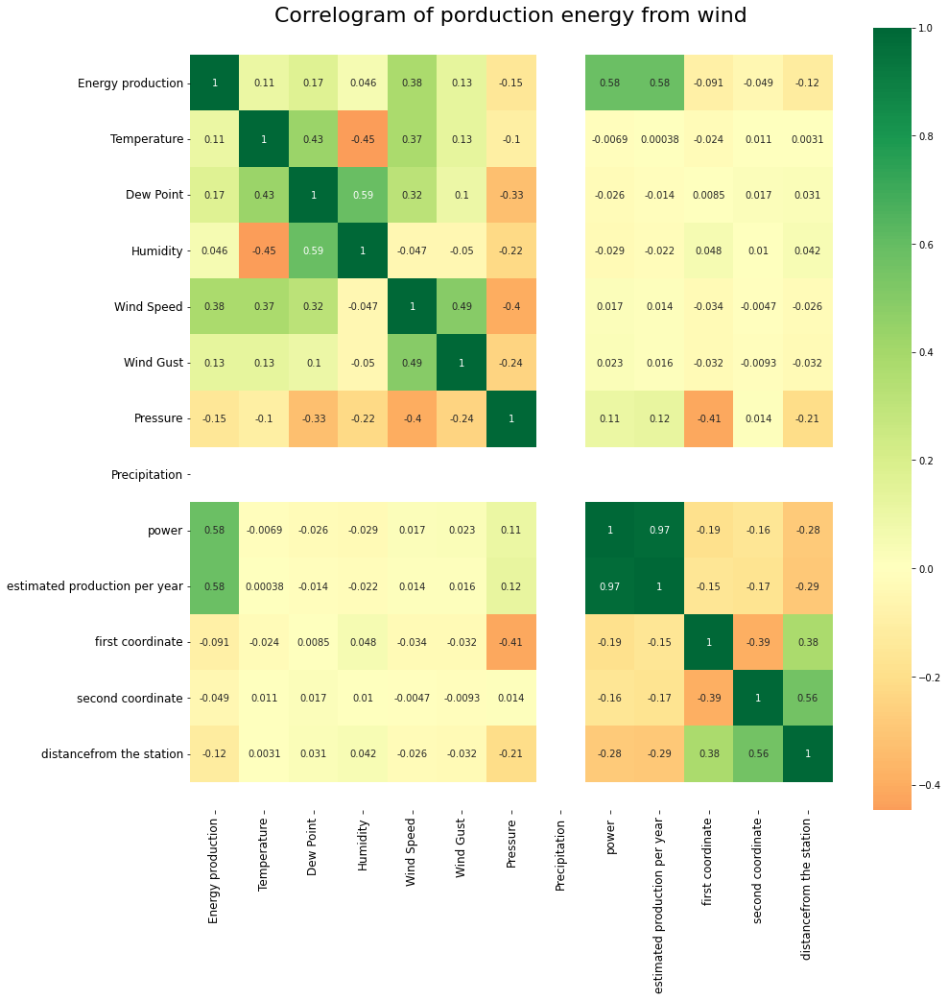

In [33]:
plt.figure(figsize=(15, 15))
ax = sns.heatmap(full_wind_df.corr(), 
                 xticklabels=full_wind_df.corr().columns, 
                 yticklabels=full_wind_df.corr().columns, 
                 cmap='RdYlGn', 
                 center=0, 
                 annot=True)

plt.title('Correlogram of porduction energy from wind', fontsize=22)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

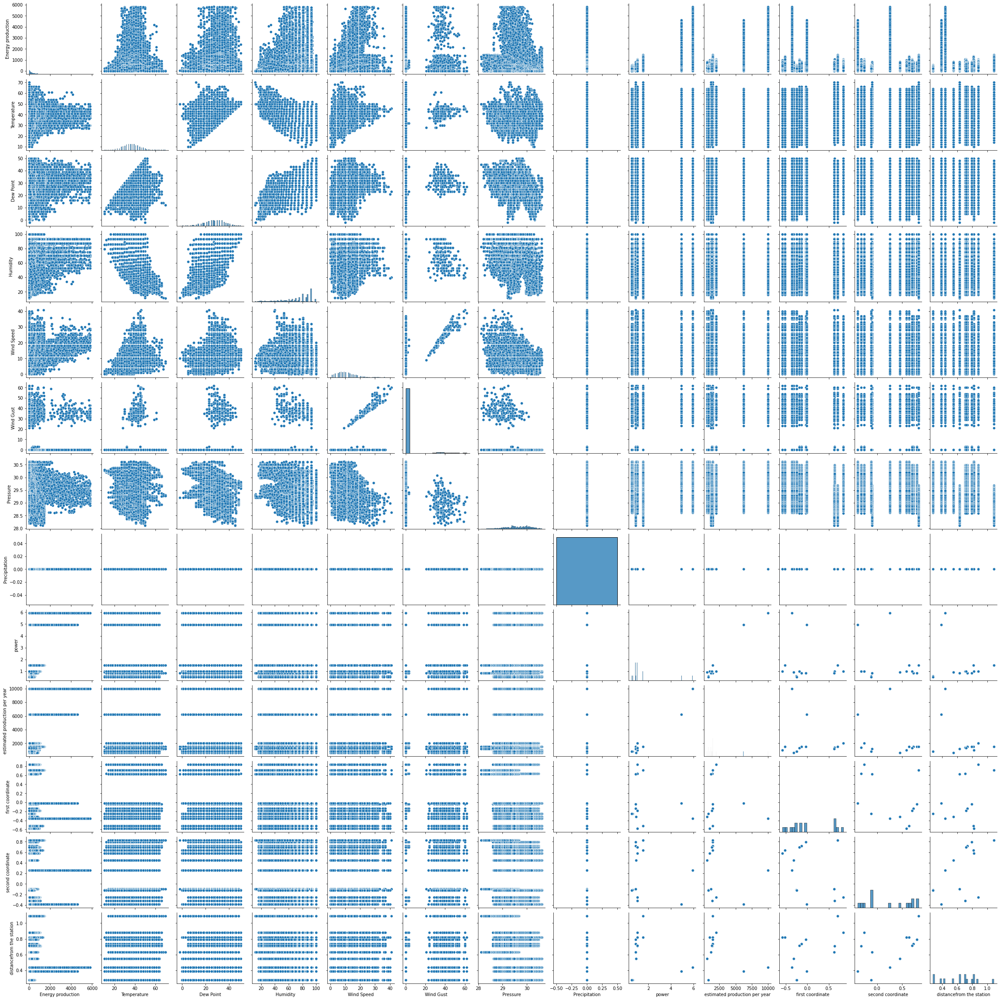

In [34]:
sns.pairplot(full_wind_df)
plt.show()

In [35]:
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Humidity',
       'Wind', 'Wind Speed', 'Wind Gust', 'Pressure', 'Precipitation',
       'Condition', 'wind_turbine', 'power', 'estimated production per year',
       'weather station', 'first coordinate', 'second coordinate',
       'distancefrom the station'],
      dtype='object')

For the purposes of data visualization, it will divide the features into several categories

In [36]:
numeric_features_on_time = ['Energy production', 'Temperature', 'Dew Point', 'Humidity', 'Wind Speed', 'Wind Gust', 'Pressure', 'Precipitation']
location_feature = ['first coordinate', 'second coordinate','distancefrom the station']
power_feature = ['power', 'estimated production per year']
categorical_features = ['Wind', 'Condition', 'wind_turbine','weather station']

First, I will check the distribution of the generated energy and wind speed over time

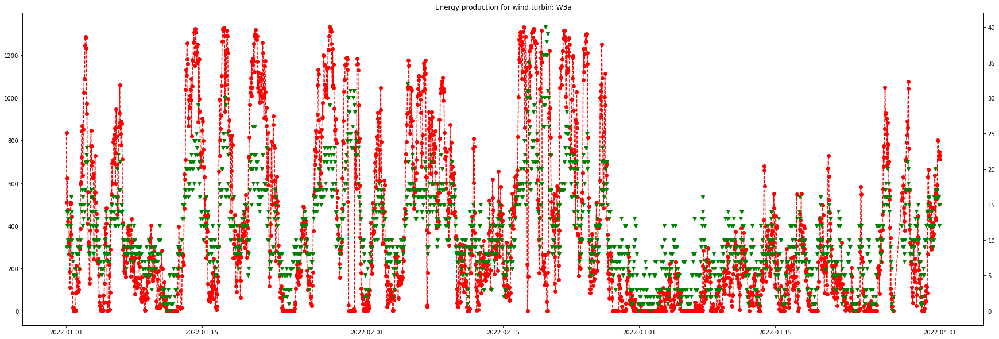

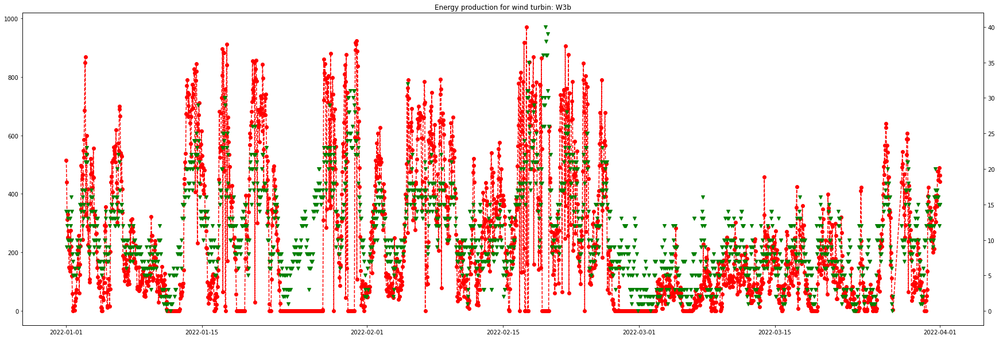

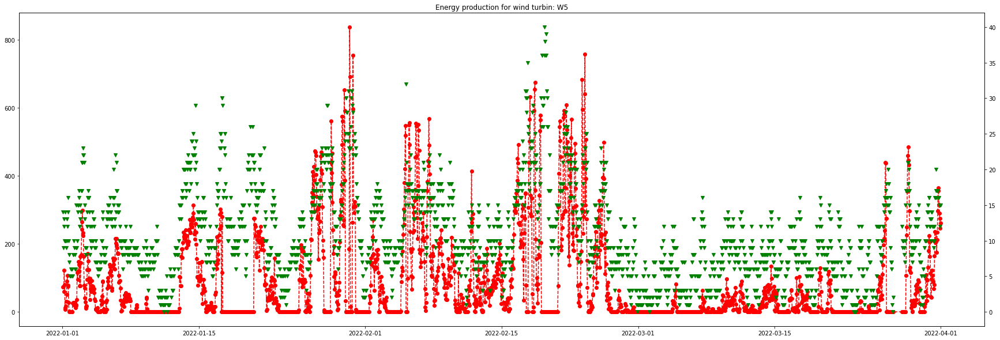

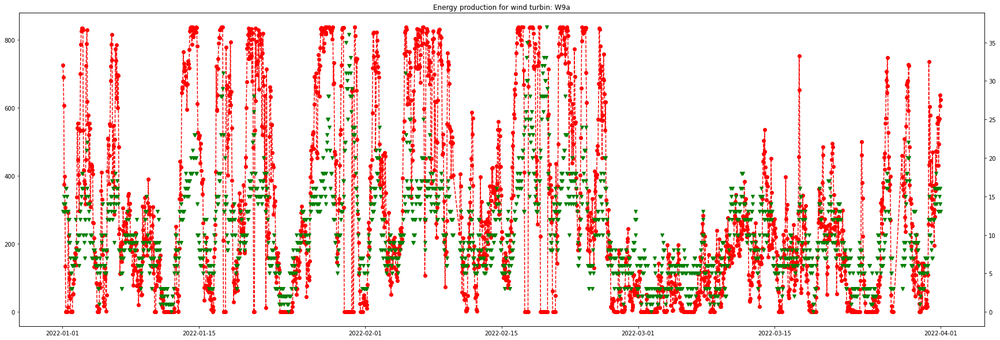

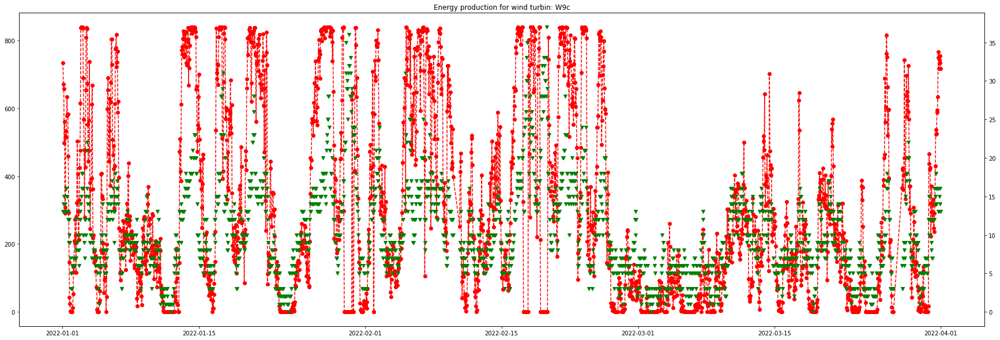

...

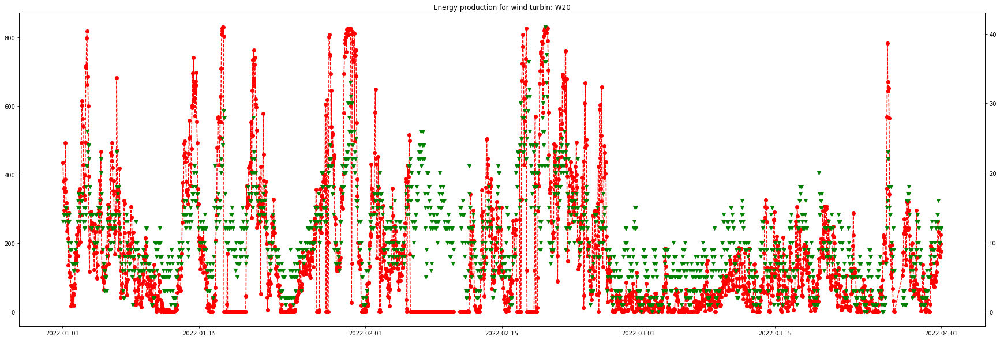

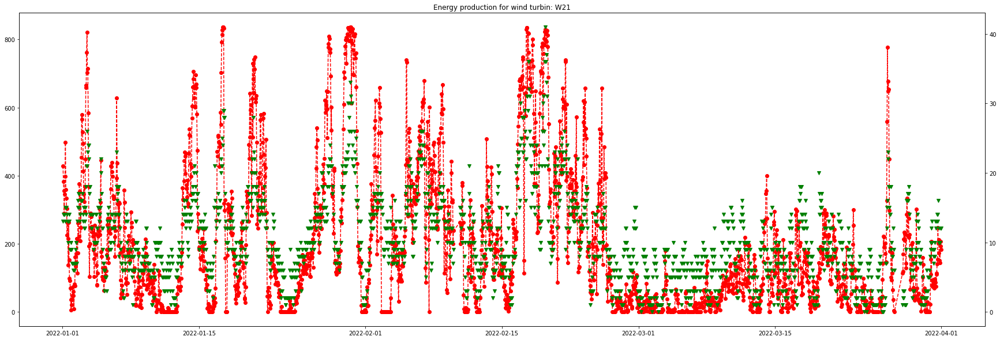

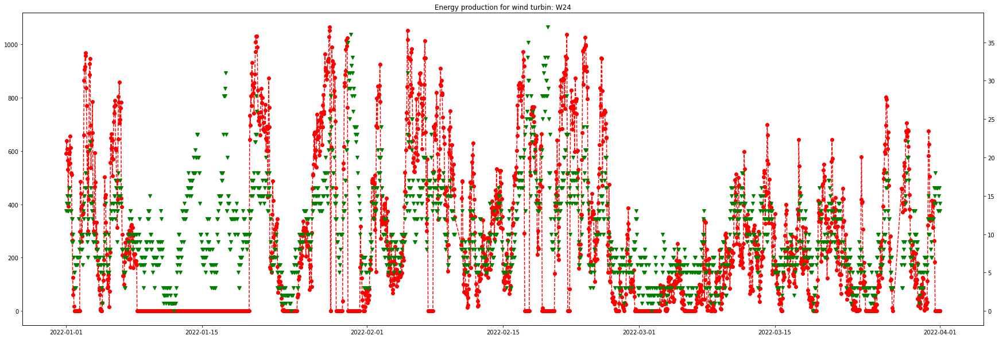

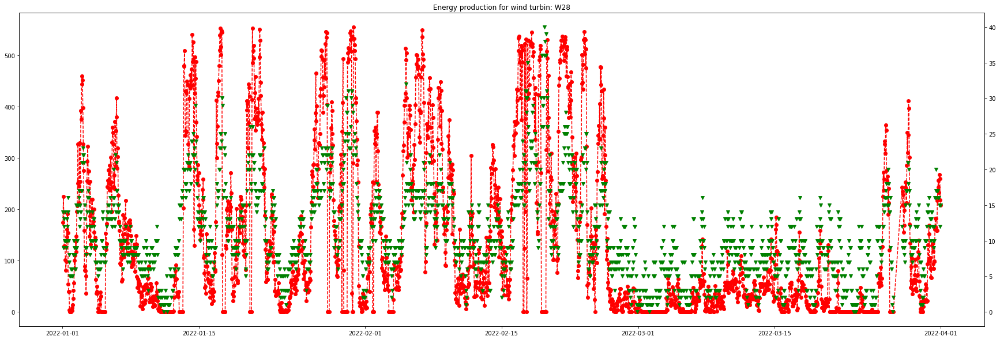

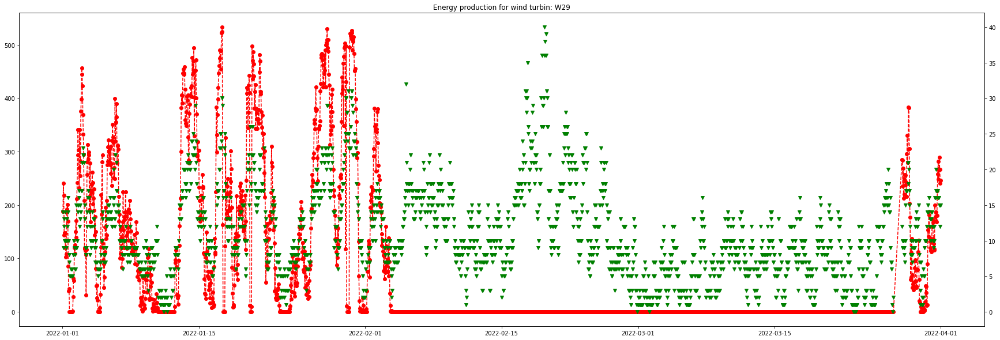

In [37]:

for i in range(0,len(list_of_windfarm)):
  fig, ax = plt.subplots(figsize=(30, 10))
  
  ax.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], marker='o', linestyle='--', color = 'r') #marker - wstawia znacznik w miejscach danych
  ax2 = ax.twinx()
  ax2.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Wind Speed'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], marker='v', linestyle='None', color = 'g')
  ax.set_title(f'Energy production for wind turbin: {list_of_windfarm[i]}')
  ax.legend
  ax

The last turbine, as you can see in the chart above, was turned off for more than half of the time for which we have data
So we will not include it in our prediction

In [38]:
full_wind_df = full_wind_df.loc[full_wind_df['wind_turbine']!='W29']
full_wind_df

,Date,Energy production,Temperature,Dew Point,Humidity,Wind,Wind Speed,Wind Gust,Pressure,Precipitation,Condition,wind_turbine,power,estimated production per year,weather station,first coordinate,second coordinate,distancefrom the station
0,2022-01-01 01:00:00,836.10,52.0,50.0,94.0,W,14.0,0.0,29.57,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
1,2022-01-01 02:00:00,510.30,50.0,48.0,94.0,NW,9.0,0.0,29.60,0.0,Light Rain,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
2,2022-01-01 03:00:00,622.80,50.0,48.0,94.0,NW,12.0,0.0,29.60,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
3,2022-01-01 04:00:00,475.74,48.0,46.0,93.0,NW,13.0,0.0,29.63,0.0,Mostly Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
4,2022-01-01 05:00:00,421.38,48.0,46.0,93.0,WNW,10.0,0.0,29.66,0.0,Cloudy,W3a,1.5,1500,S3,-0.517309,0.633981,0.818255
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30221,2022-03-31 20:00:00,233.28,39.0,9.0,28.0,NE,16.0,0.0,29.45,0.0,Fair,W28,0.6,800,S3,-0.252376,-0.115658,0.277616
30222,2022-03-31 21:00:00,267.21,37.0,9.0,30.0,NE,15.0,0.0,29.45,0.0,Fair,W28,0.6,800,S3,-0.252376,-0.115658,0.277616
30223,2022-03-31 22:00:00,259.47,37.0,9.0,30.0,NE,12.0,0.0,29.48,0.0,Fair,W28,0.6,800,S3,-0.252376,-0.115658,0.277616
30224,2022-03-31 23:00:00,218.16,36.0,10.0,35.0,NE,15.0,0.0,29.48,0.0,Fair,W28,0.6,800,S3,-0.252376,-0.115658,0.277616


In [39]:
full_wind_df['wind_turbine'].value_counts(normalize=True)

W3a    0.071709
W3b    0.071709
W5     0.071709
W9d    0.071709
W15    0.071709
W28    0.071709
W19    0.071239
W20    0.071239
W21    0.071239
W9a    0.071206
W9c    0.071206
W13    0.071206
W14    0.071206
W24    0.071206
Name: wind_turbine, dtype: float64

In [40]:
list_of_windfarm.remove('W29')
list_of_windfarm

['W3a',
 'W3b',
 'W5',
 'W9a',
 'W9c',
 'W9d',
 'W13',
 'W14',
 'W15',
 'W19',
 'W20',
 'W21',
 'W24',
 'W28']

Do the same for temperature

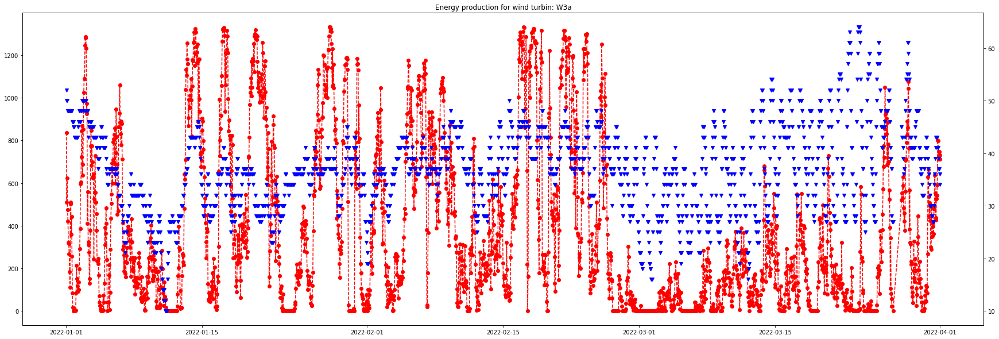

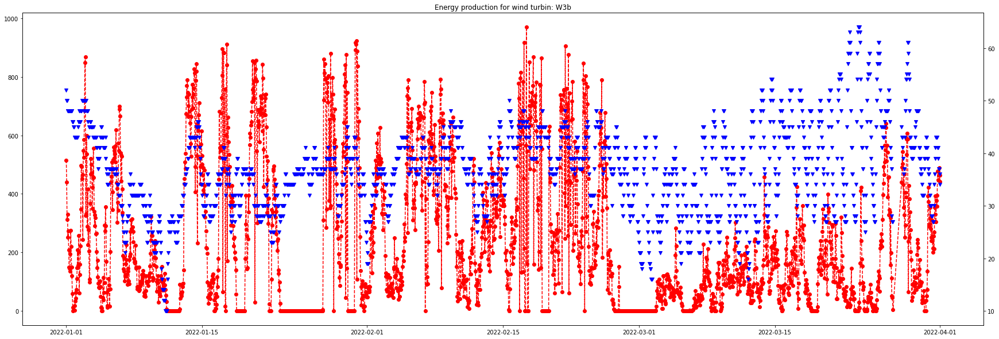

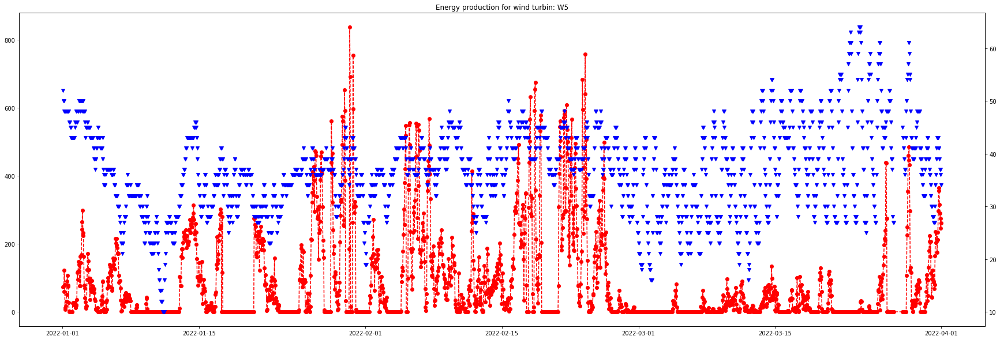

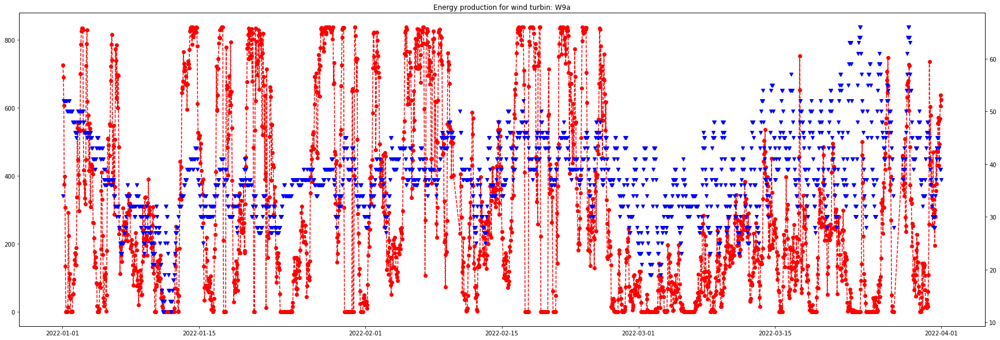

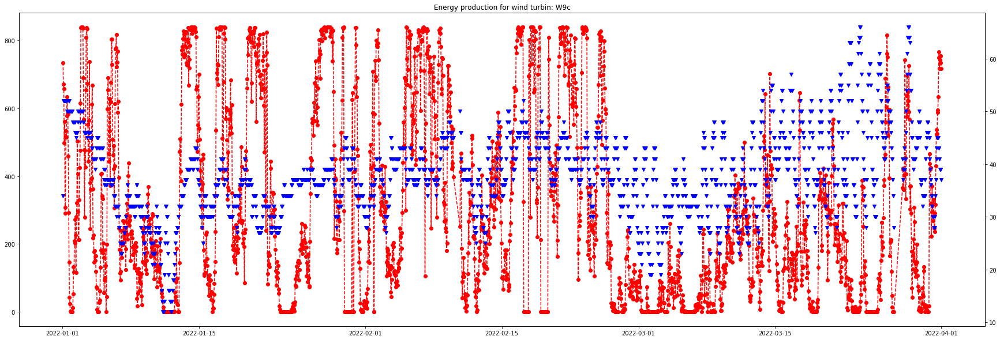

...

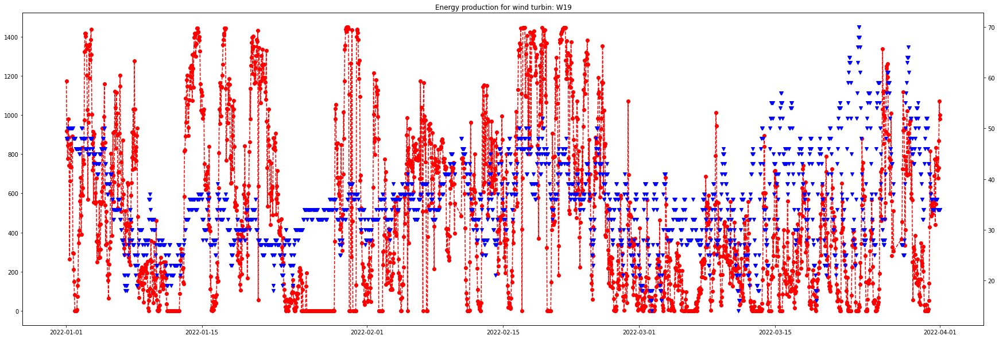

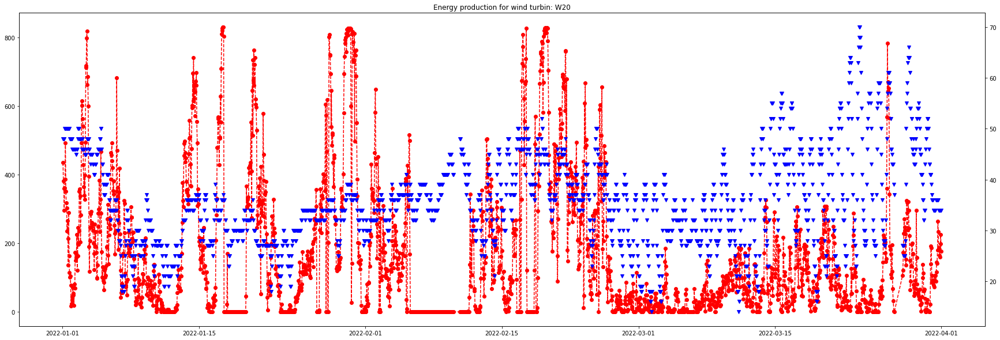

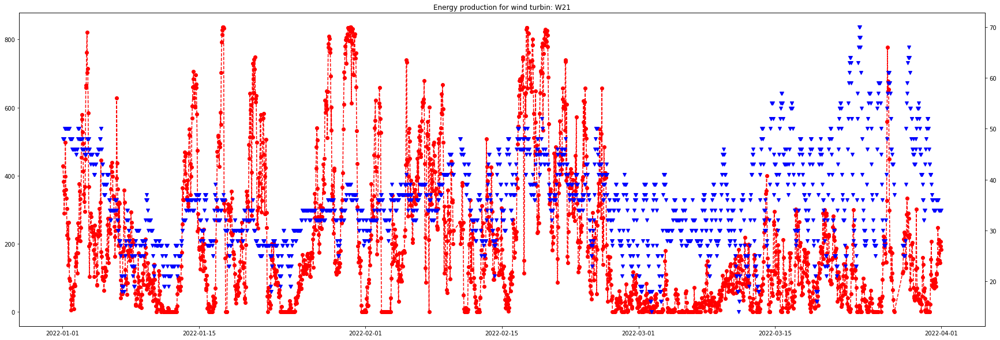

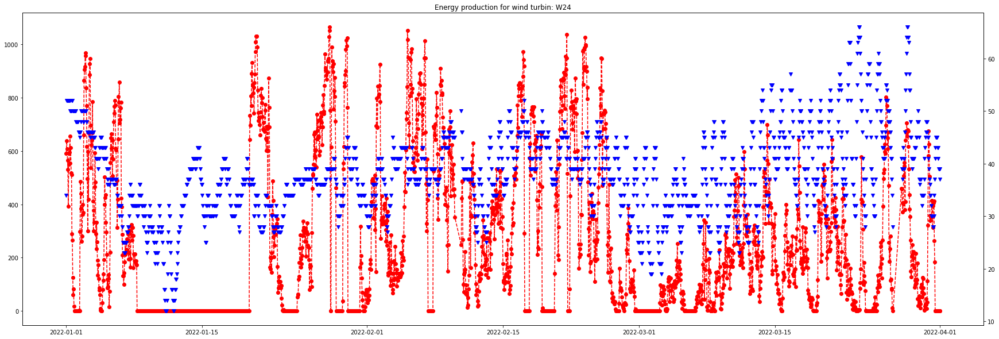

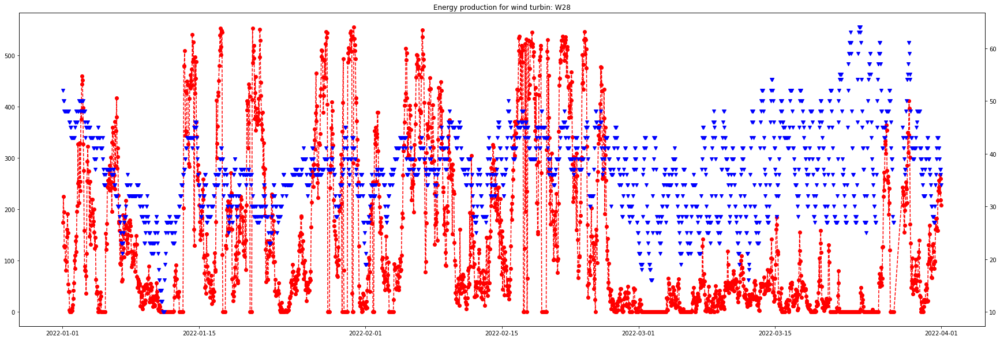

In [41]:
for i in range(0,len(list_of_windfarm)):
  fig, ax = plt.subplots(figsize=(30, 10))
  
  ax.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], 
          marker='o', linestyle='--', color = 'r')
  ax2 = ax.twinx()
  ax2.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Temperature'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], 
           marker='v', linestyle='None', color = 'b')
  ax.set_title(f'Energy production for wind turbin: {list_of_windfarm[i]}')
  
  ax

We can see that the amount of energy produced compared to the other characteristics behaves the same regardless of the wind turbine

Then let's check how our other features behave over time,
we will check it on the example of the first wind turbine

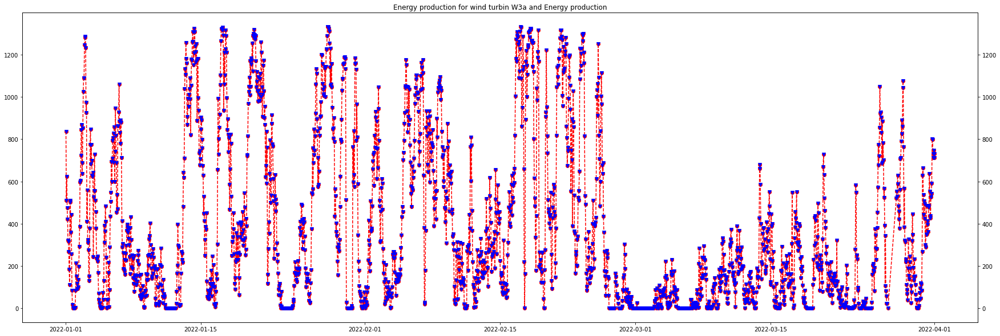

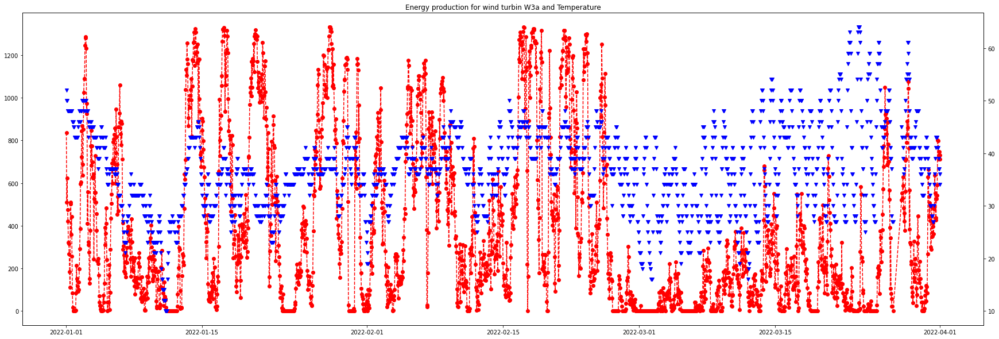

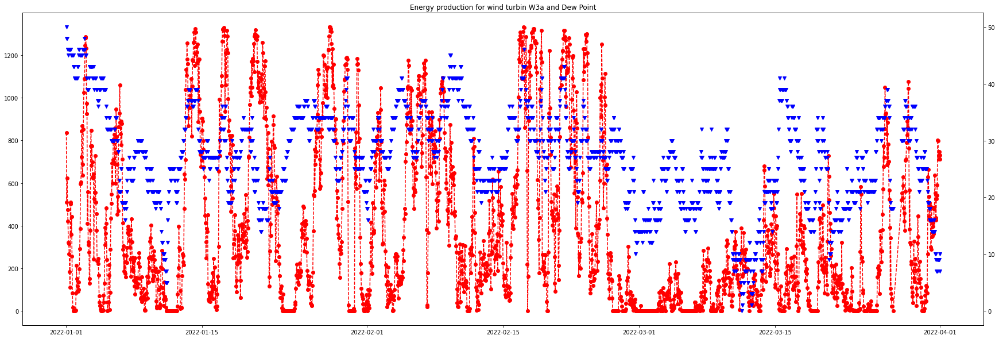

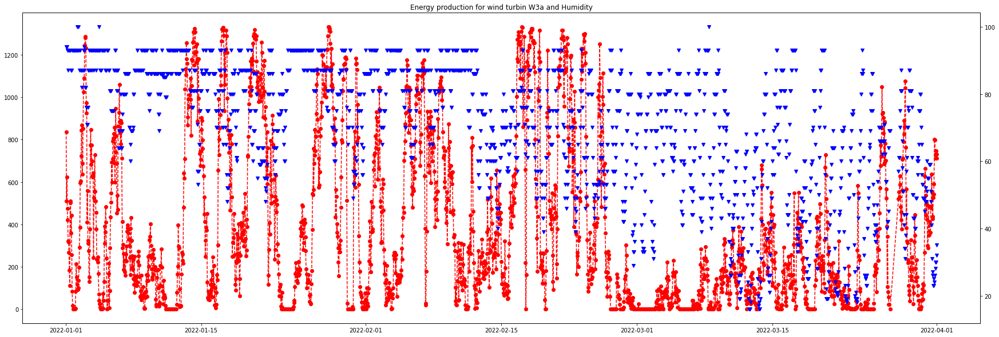

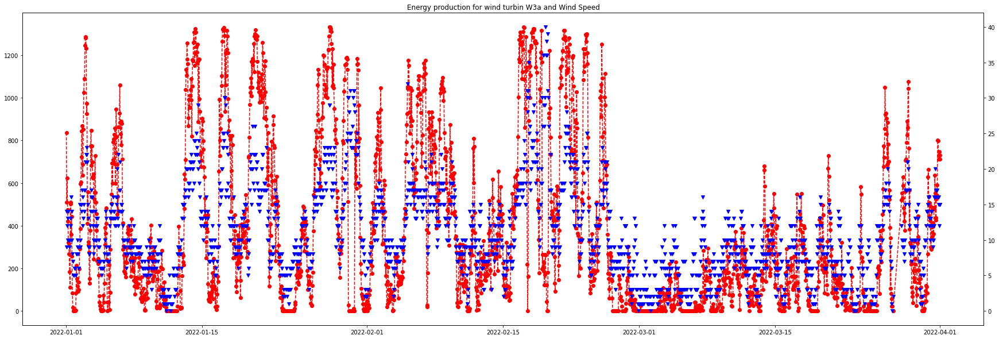

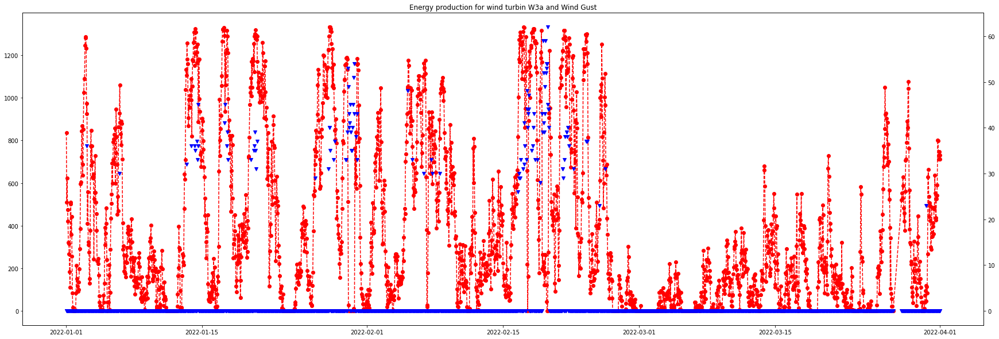

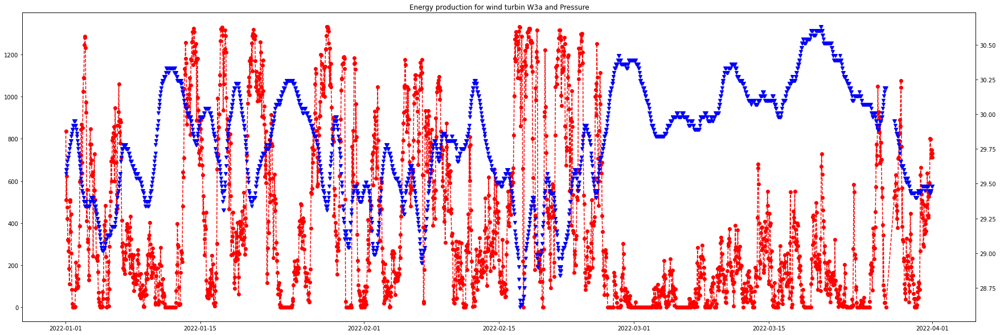

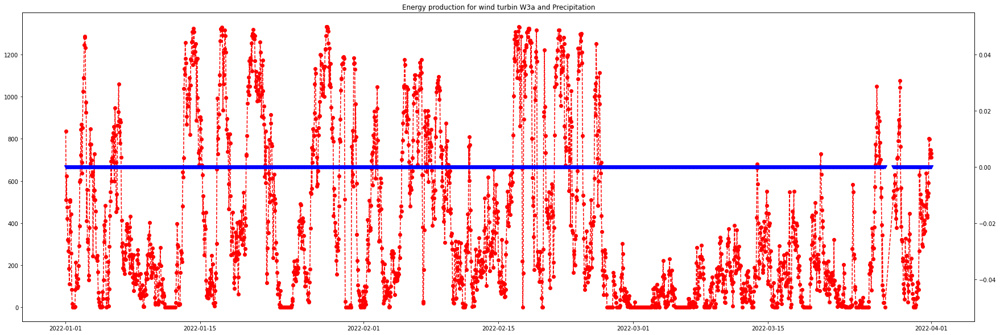

In [42]:
for num in numeric_features_on_time:
  fig, ax = plt.subplots(figsize=(30, 10))
  
  ax.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[0]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[0]], 
          marker='o', linestyle='--', color = 'r') 
  ax2 = ax.twinx()
  ax2.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[0]], full_wind_df[num].loc[full_wind_df['wind_turbine']==list_of_windfarm[0]], 
           marker='v', linestyle='None', color = 'b')
  ax.set_title(f'Energy production for wind turbin {list_of_windfarm[0]} and {num}')
  
  ax

The precipitation in the analyzed period of time was at a constant level equal to 0, so we can assume that its amount does not affect the volume of generated energy
Wwe will remove this feature from our dataset

In [43]:
full_wind_df  =  full_wind_df.drop(columns=['Precipitation'], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Humidity',
       'Wind', 'Wind Speed', 'Wind Gust', 'Pressure', 'Condition',
       'wind_turbine', 'power', 'estimated production per year',
       'weather station', 'first coordinate', 'second coordinate',
       'distancefrom the station'],
      dtype='object')

In [44]:
numeric_features_on_time.remove('Precipitation')
numeric_features_on_time

['Energy production',
 'Temperature',
 'Dew Point',
 'Humidity',
 'Wind Speed',
 'Wind Gust',
 'Pressure']

Let's check on the example of another turbine whether our features behave the same

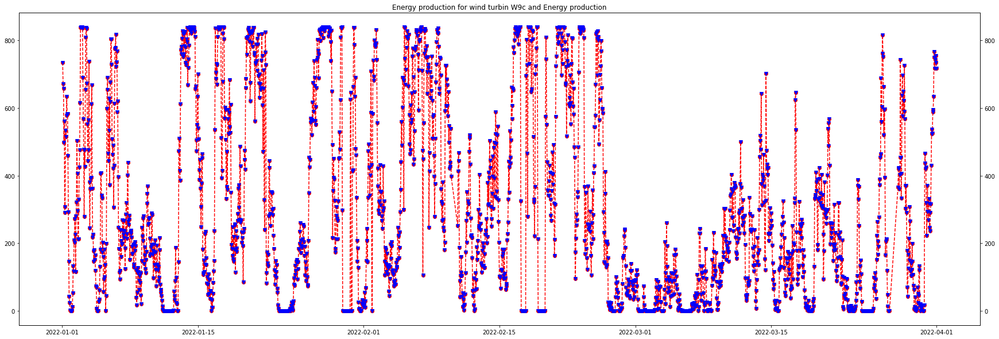

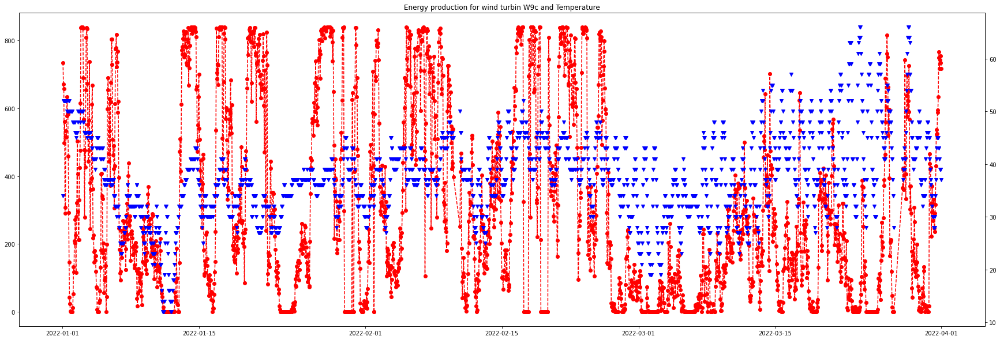

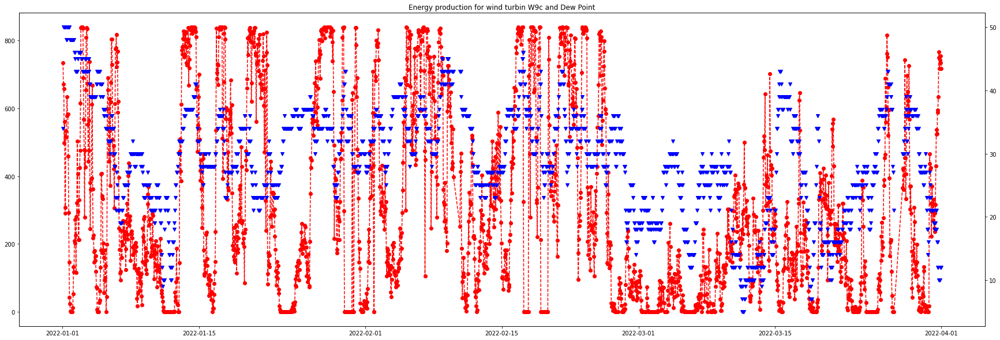

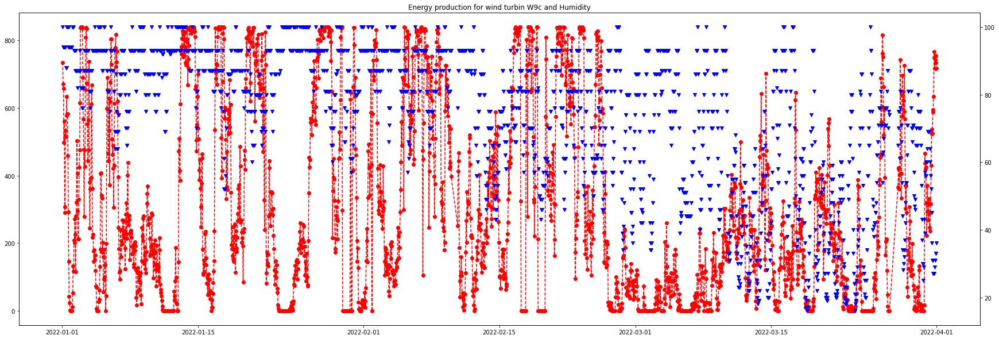

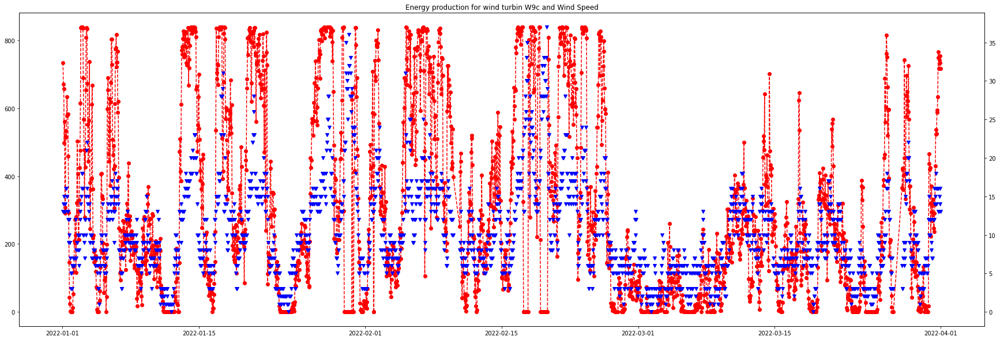

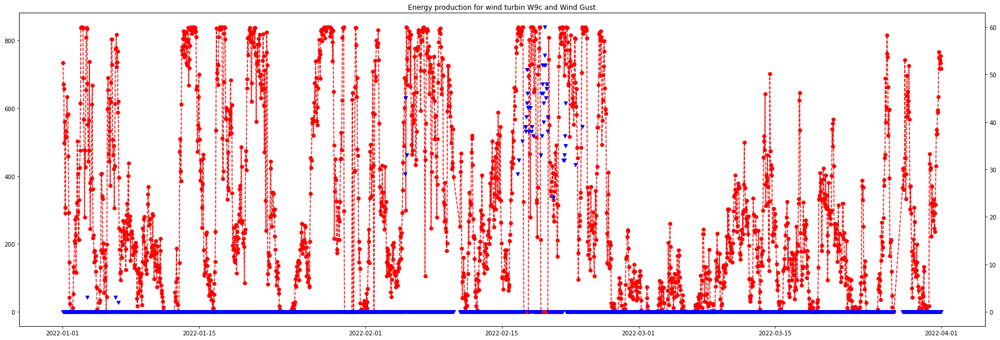

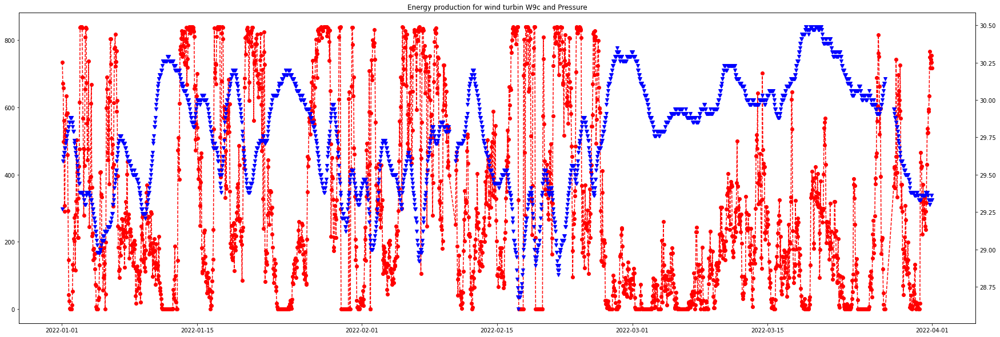

In [45]:
for num in numeric_features_on_time:
  fig, ax = plt.subplots(figsize=(30, 10))
  
  ax.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[4]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[4]], 
          marker='o', linestyle='--', color = 'r') 
  ax2 = ax.twinx()
  ax2.plot(full_wind_df['Date'].loc[full_wind_df['wind_turbine']==list_of_windfarm[4]], full_wind_df[num].loc[full_wind_df['wind_turbine']==list_of_windfarm[4]], 
           marker='v', linestyle='None', color = 'b')
  ax.set_title(f'Energy production for wind turbin {list_of_windfarm[4]} and {num}')
  
  ax

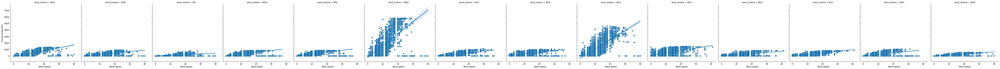

In [46]:
sns.lmplot(x='Wind Speed', y='Energy production', col='wind_turbine', data=full_wind_df )

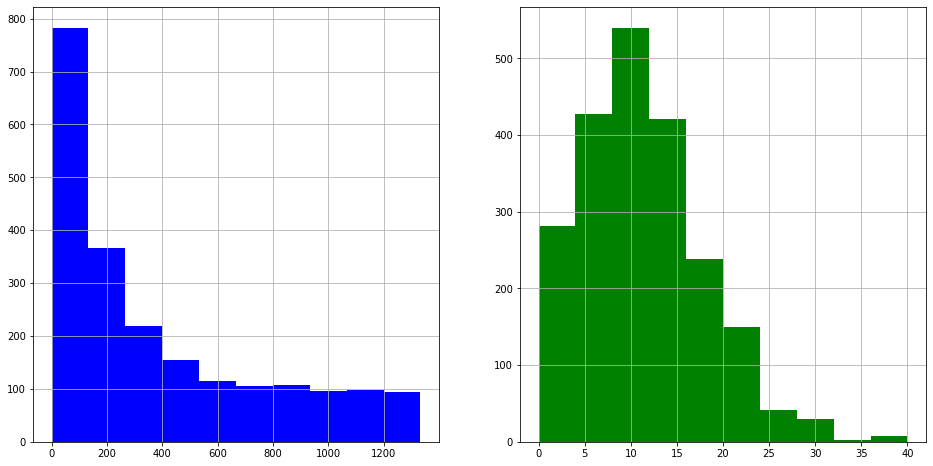

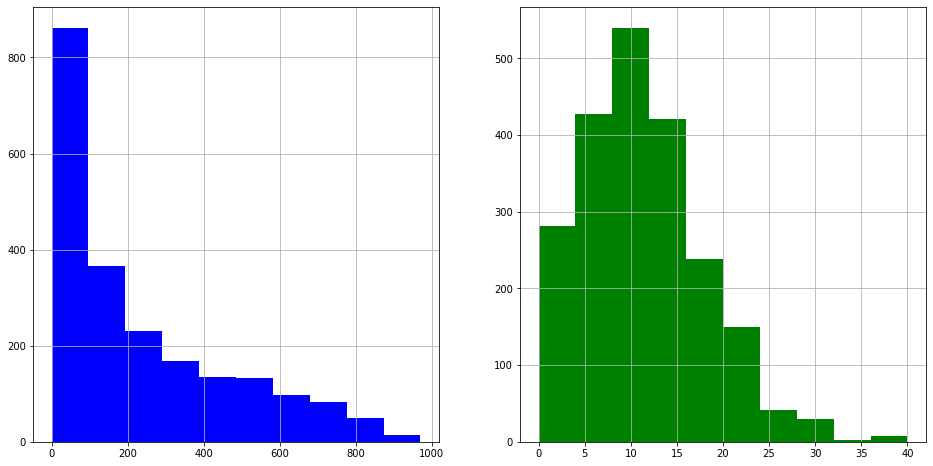

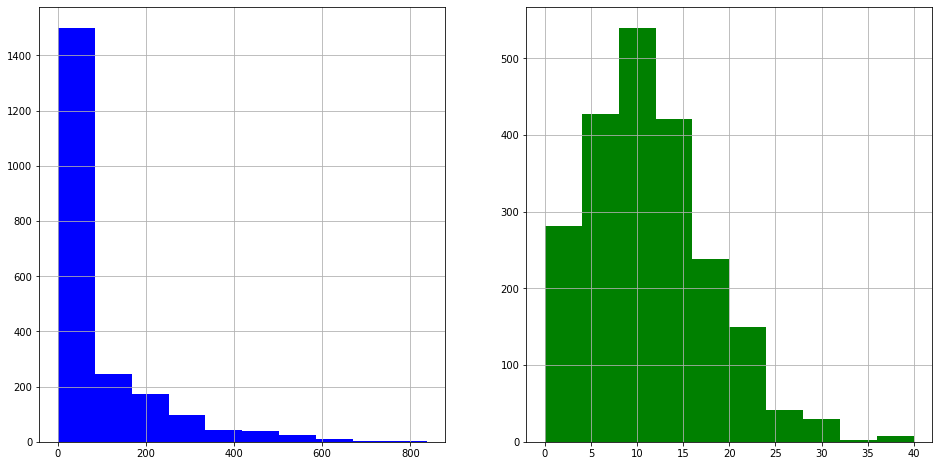

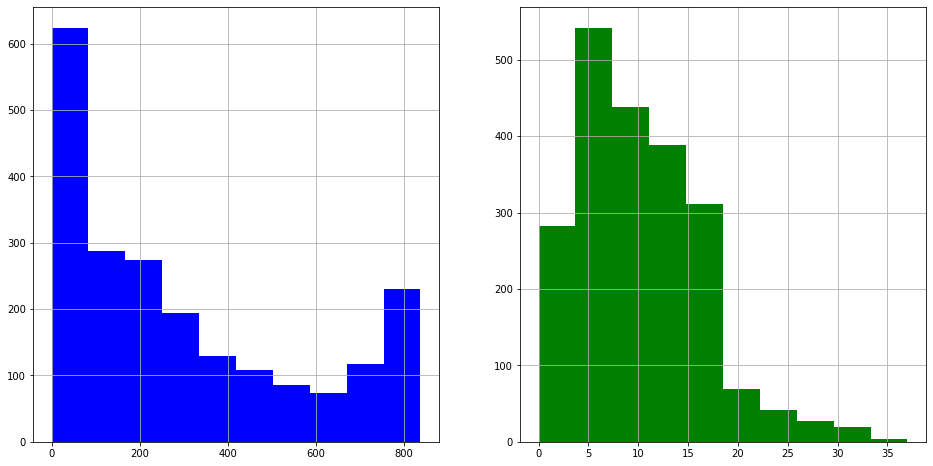

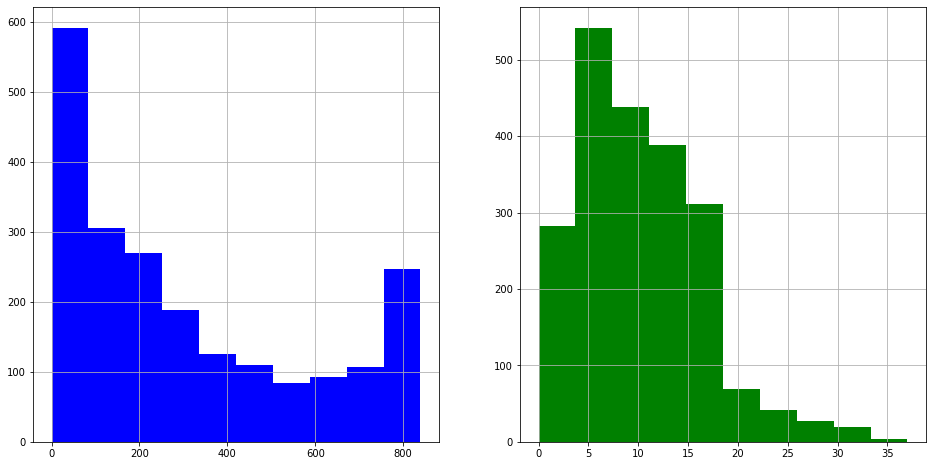

...

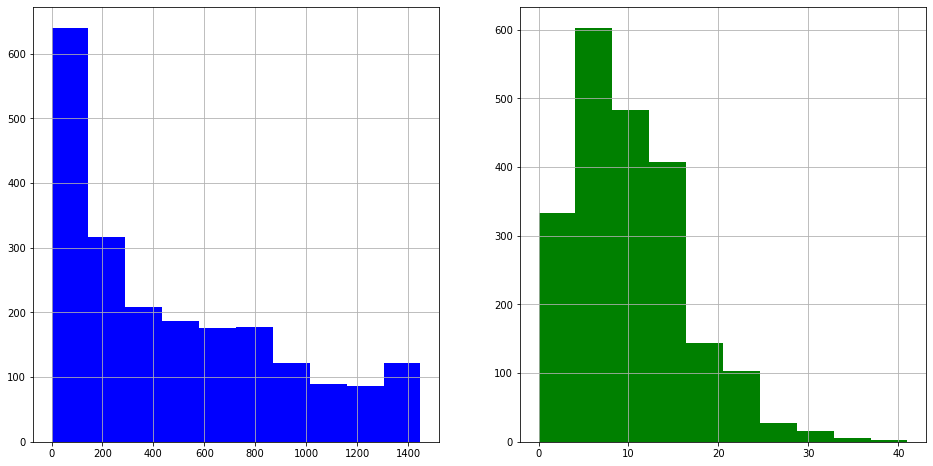

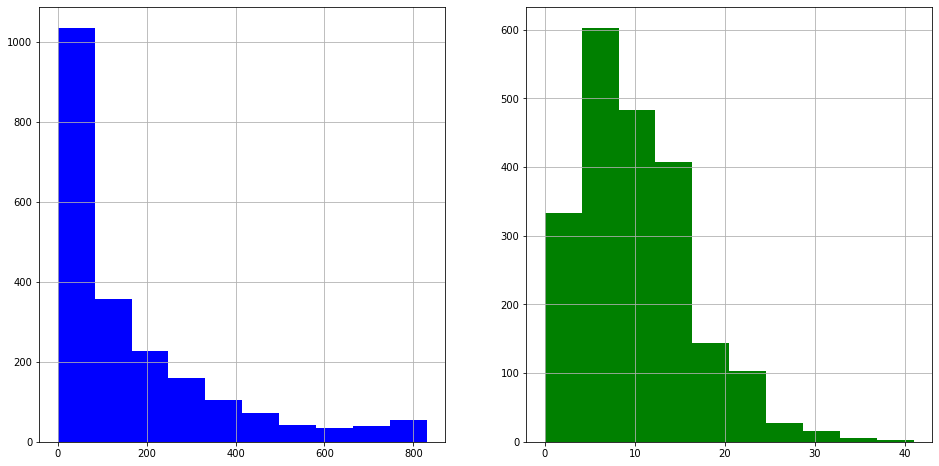

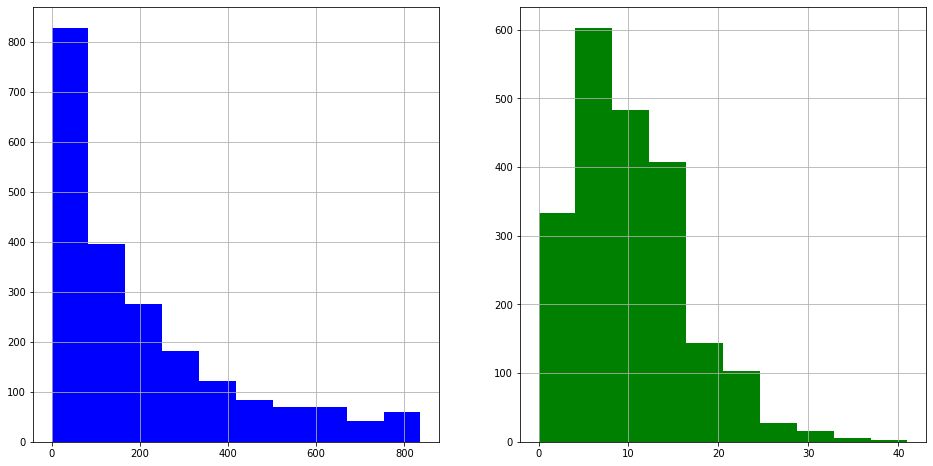

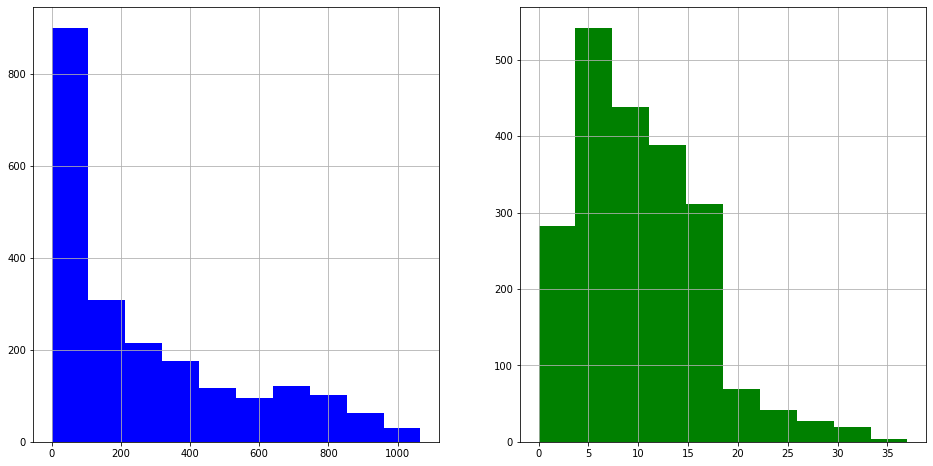

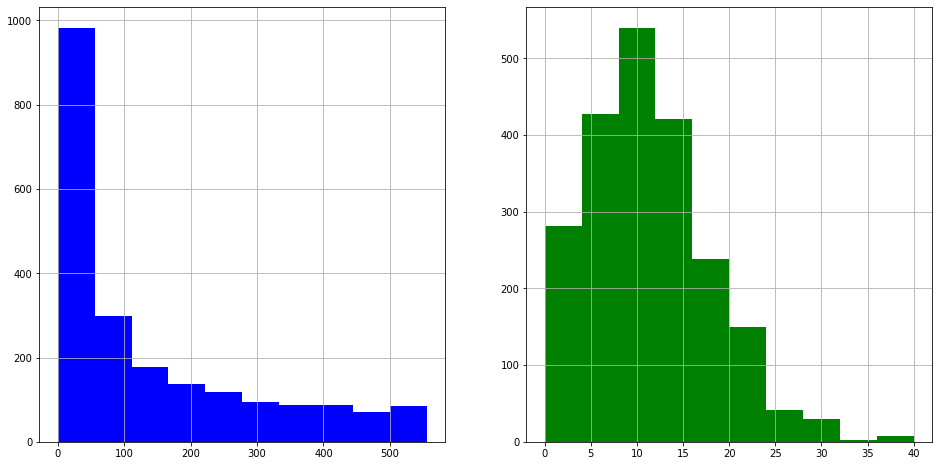

In [47]:
for i in list_of_windfarm:
  fig, axes = plt.subplots(1,2, figsize=(16, 8))
  full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==i].hist( color = 'b', ax=axes[0])
  full_wind_df['Wind Speed'].loc[full_wind_df['wind_turbine']==i].hist(color = 'g', ax=axes[1])

  ax

let's see how the generated energy depends on the wind speed

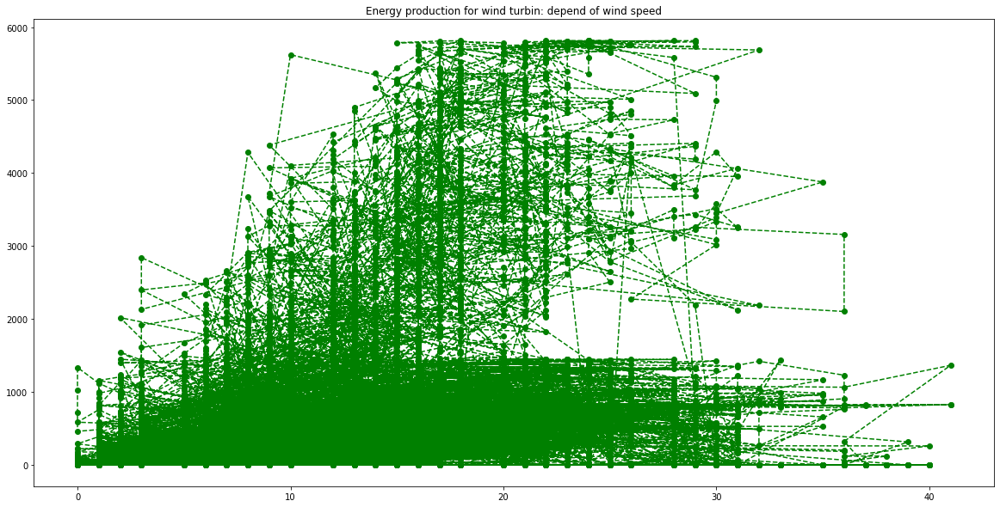

In [48]:
fig, ax = plt.subplots(figsize=(20, 10))
  
ax.plot(full_wind_df['Wind Speed'], full_wind_df['Energy production'], 
          marker='o', linestyle='--', color = 'g')
ax.set_title(f'Energy production for wind turbin: depend of wind speed')
  
ax

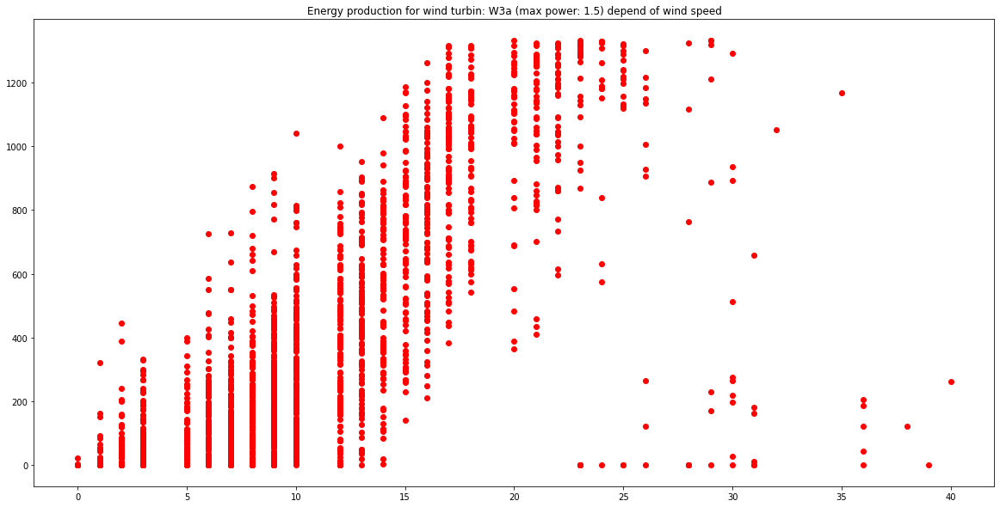

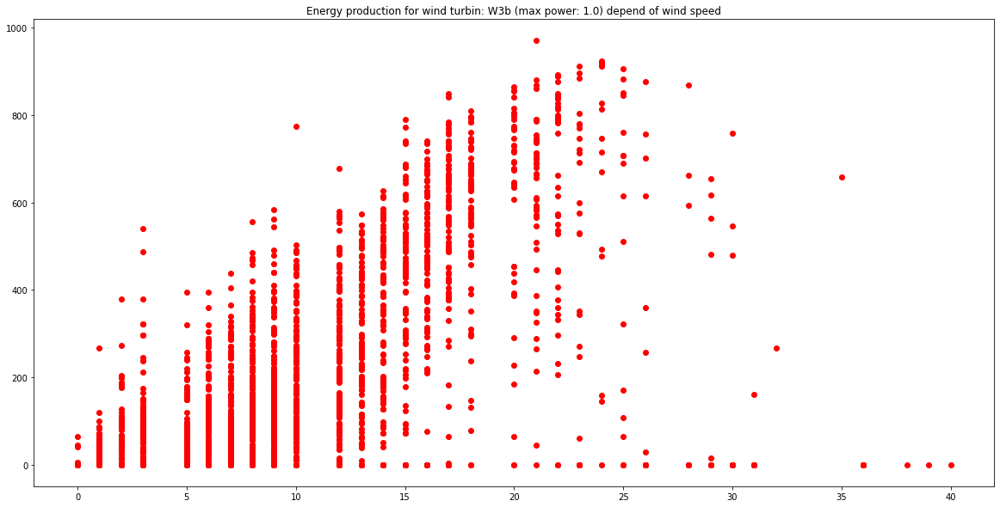

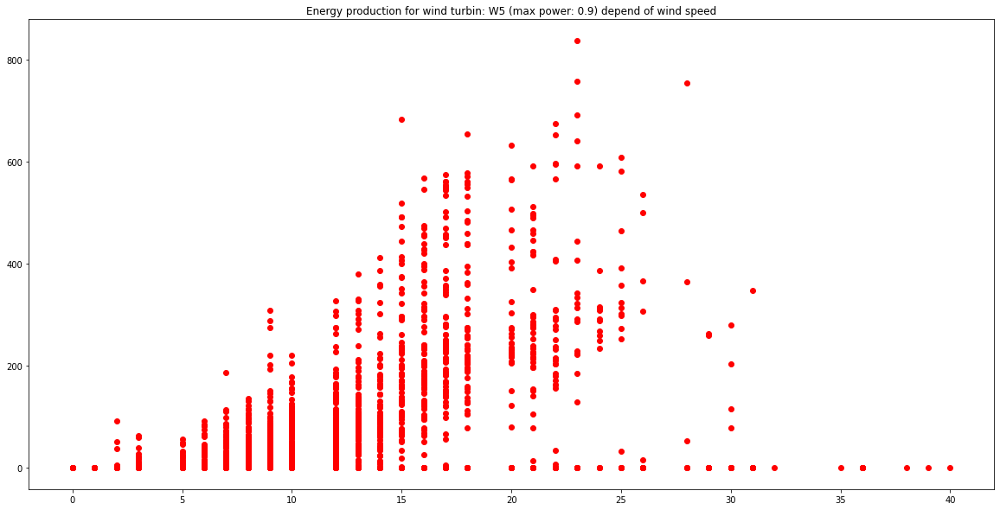

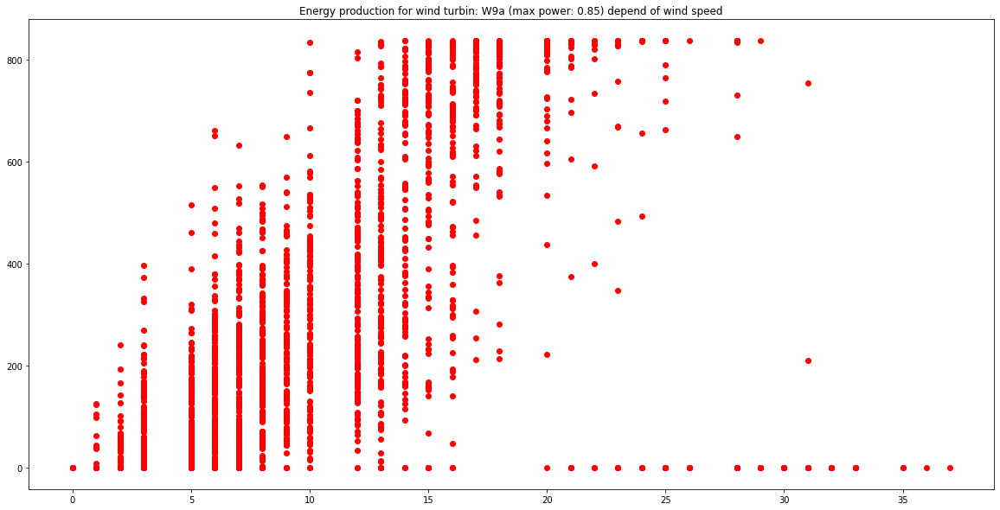

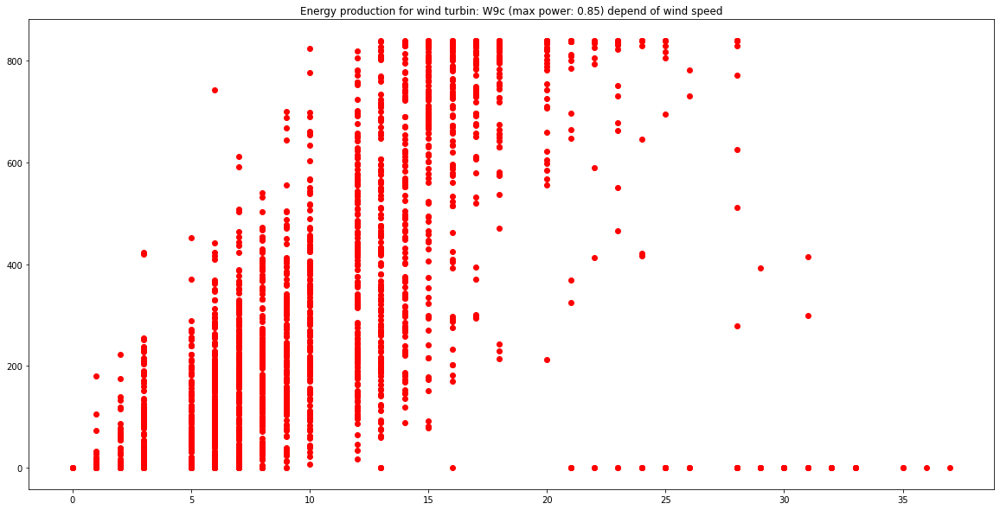

...

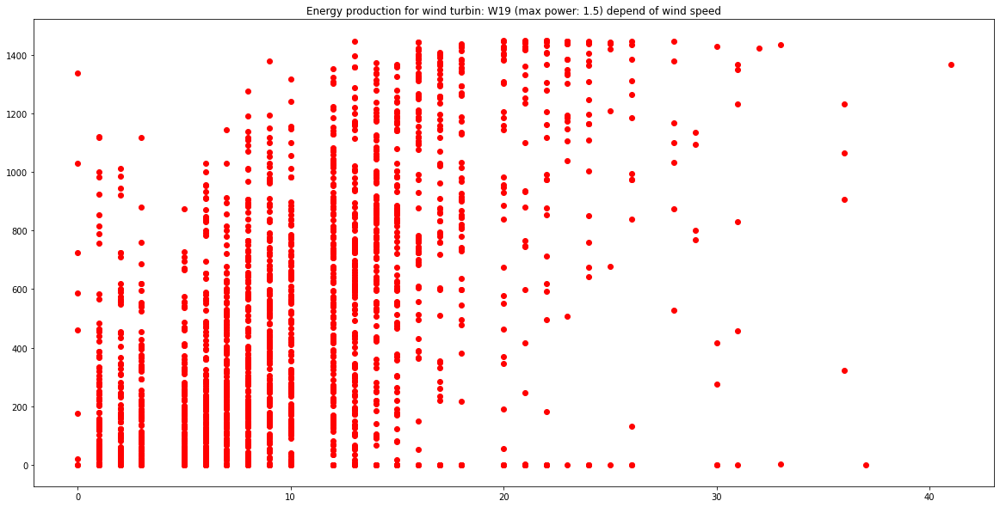

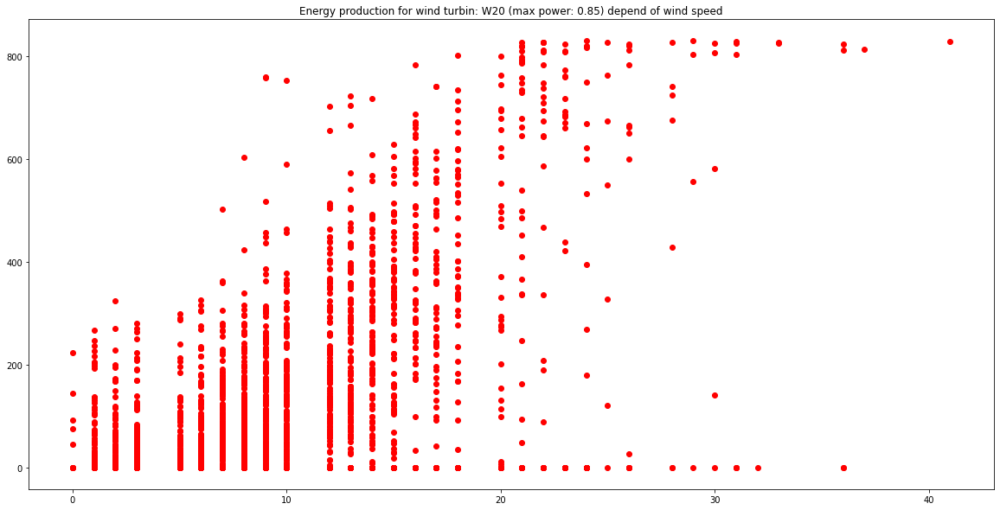

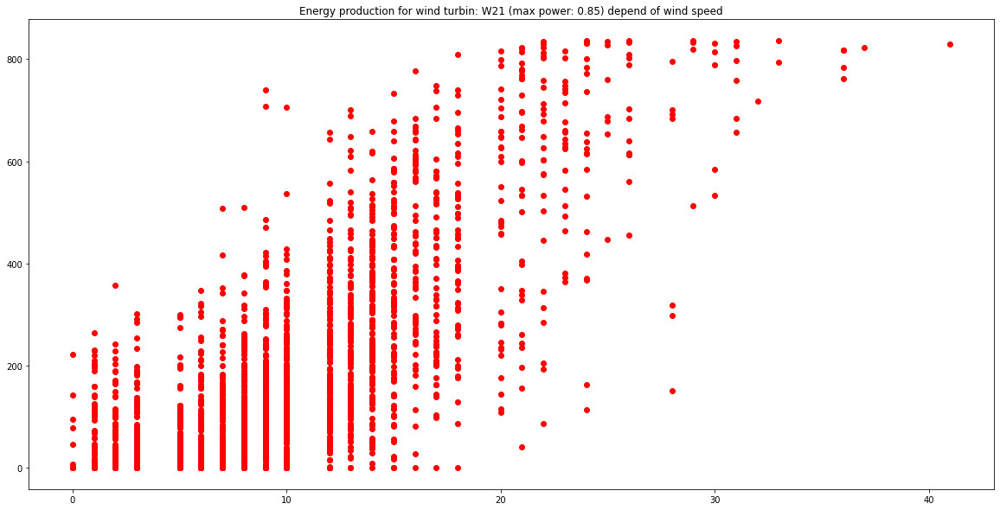

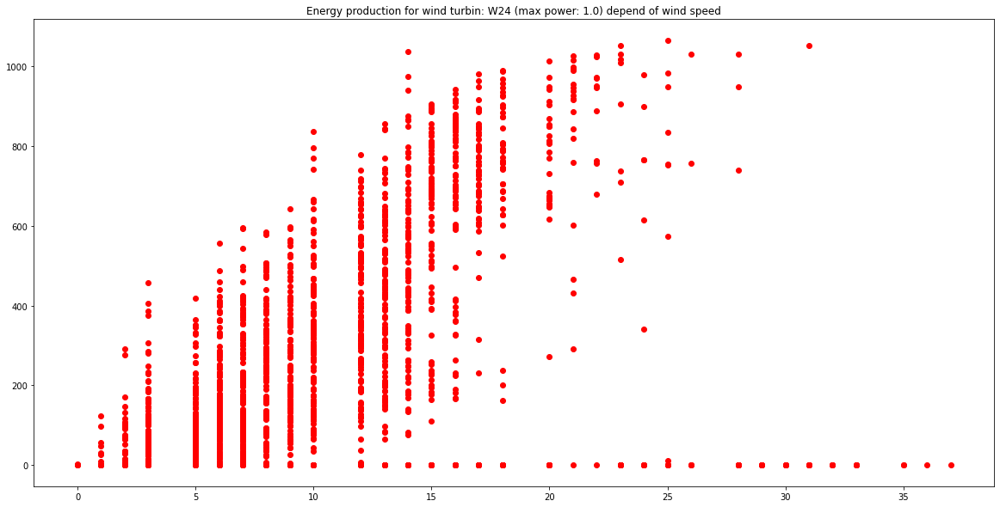

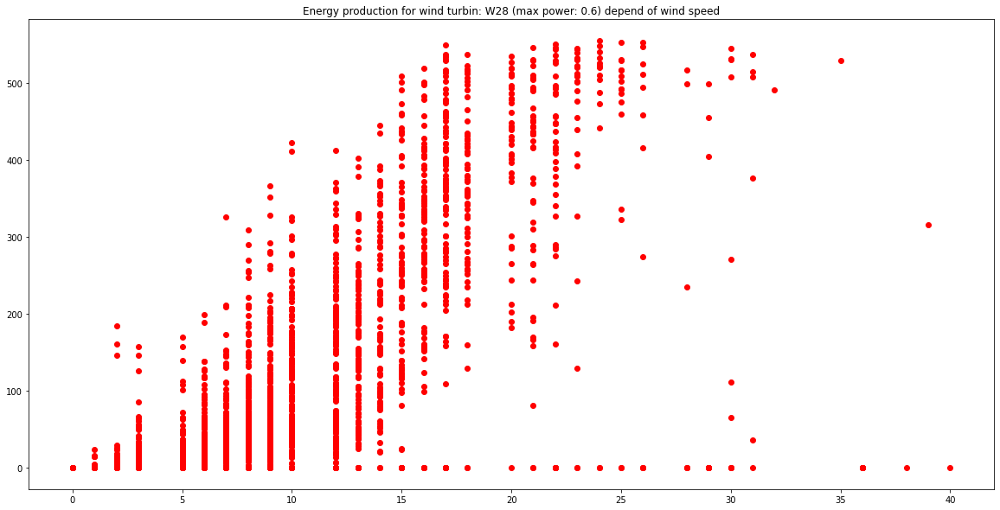

In [49]:
for i in range(0,len(list_of_windfarm)):
  fig, ax = plt.subplots(figsize=(20, 10))
  
  ax.scatter(full_wind_df['Wind Speed'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], 
          marker='o', color = 'r')
  
  ax.set_title(f"Energy production for wind turbin: {list_of_windfarm[i]} (max power: {windfarm['power'][i]}) depend of wind speed")
  
  ax

the amount of generated energy increases with the increase in wind speed until the maximum value equal to the power of wind turbine

Let's see how the generated energy behaves depending on the other characteristics

In [50]:
numeric_features_on_time.remove('Energy production')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


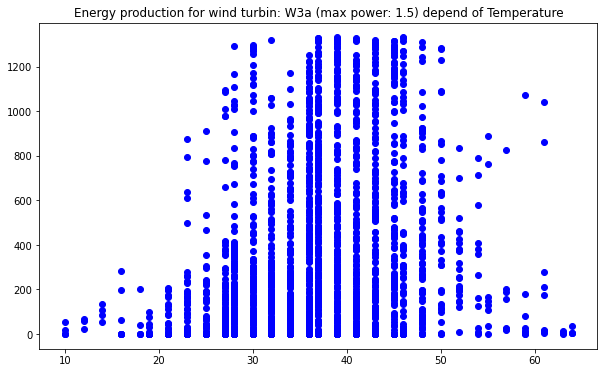

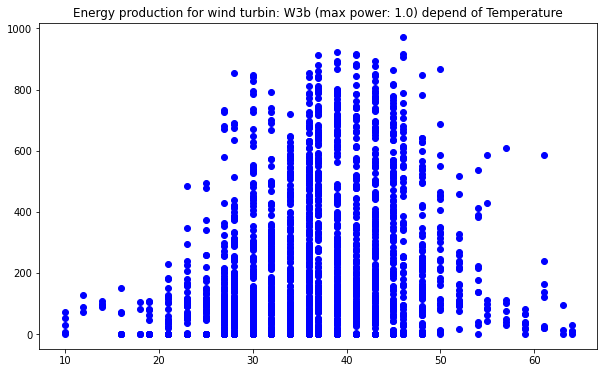

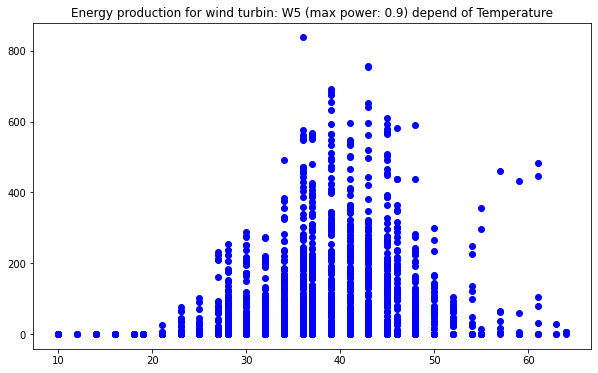

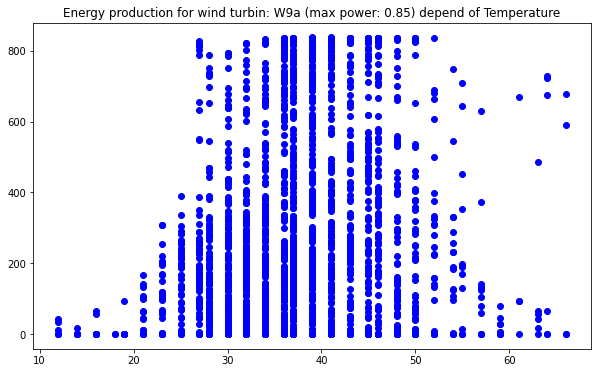

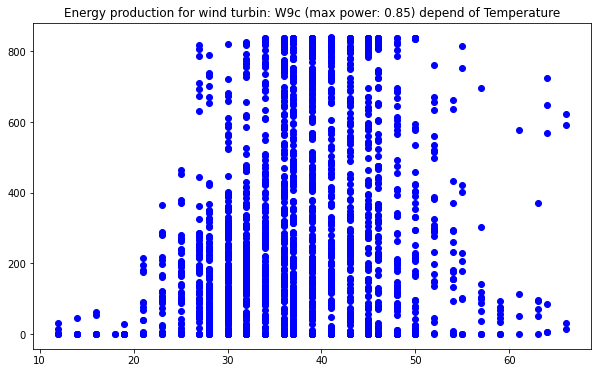

...

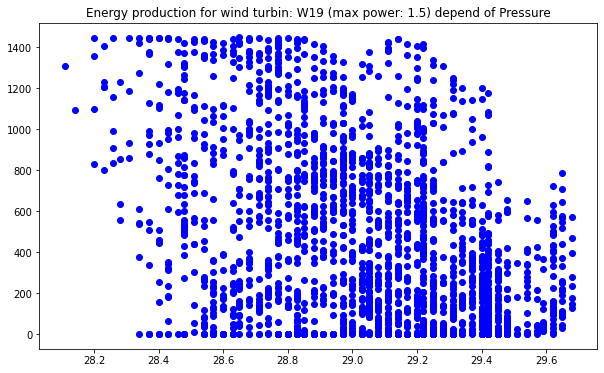

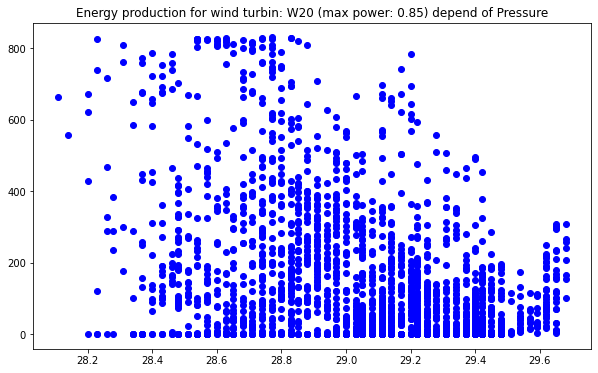

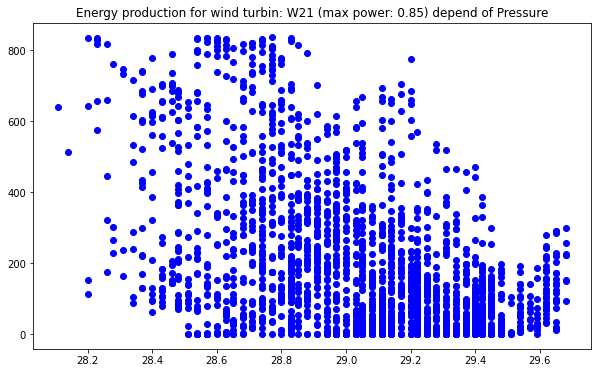

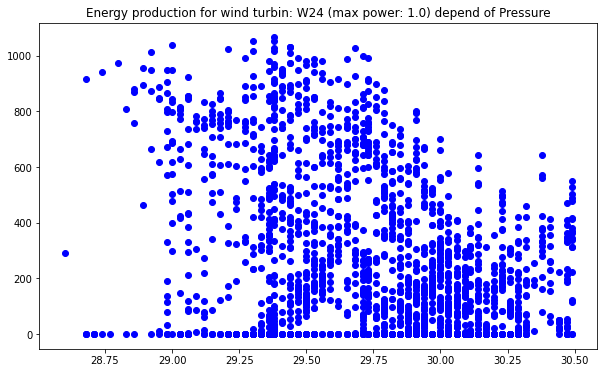

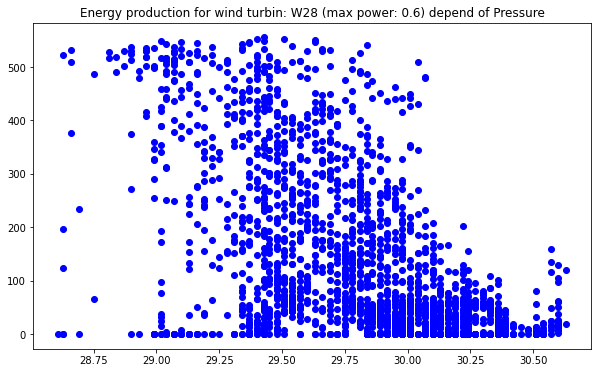

In [51]:

for num in numeric_features_on_time:
  for i in range(0,len(list_of_windfarm)):
    fig, ax = plt.subplots(figsize=(10, 6))
    
    ax.scatter(full_wind_df[num].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Energy production'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], 
            marker='o', color = 'b')
    
    ax.set_title(f"Energy production for wind turbin: {list_of_windfarm[i]} (max power: {windfarm['power'][i]}) depend of {num}")
    
    ax

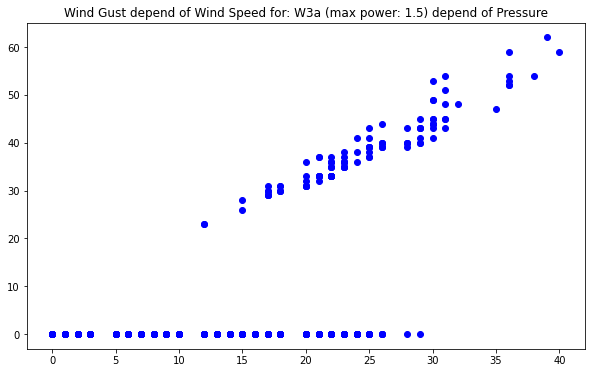

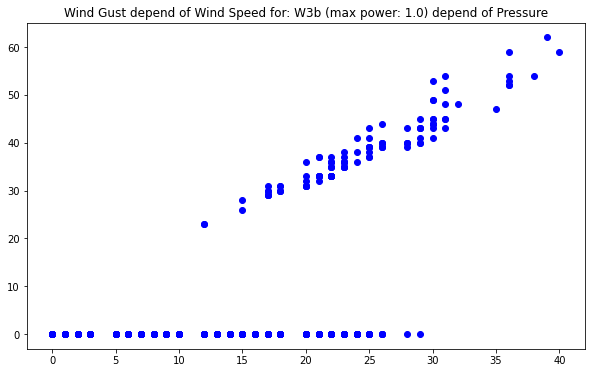

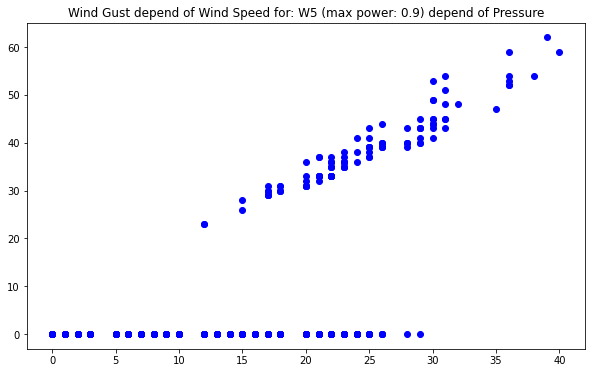

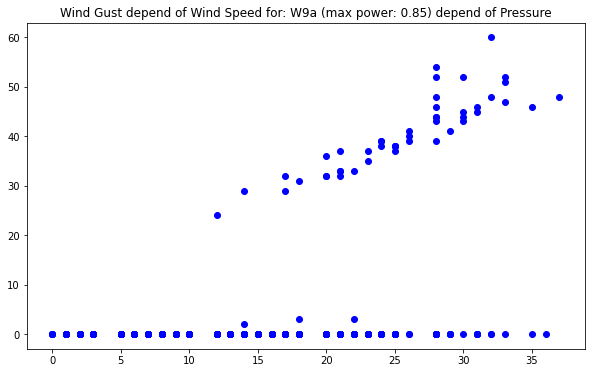

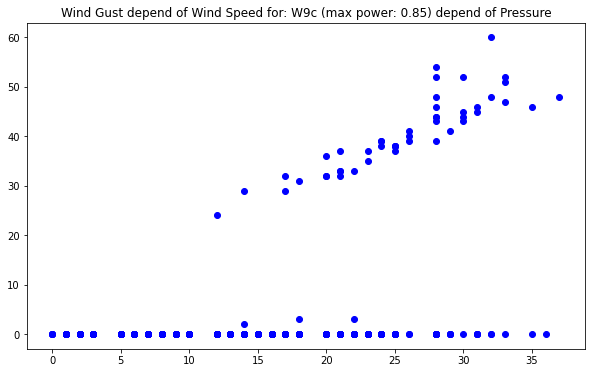

...

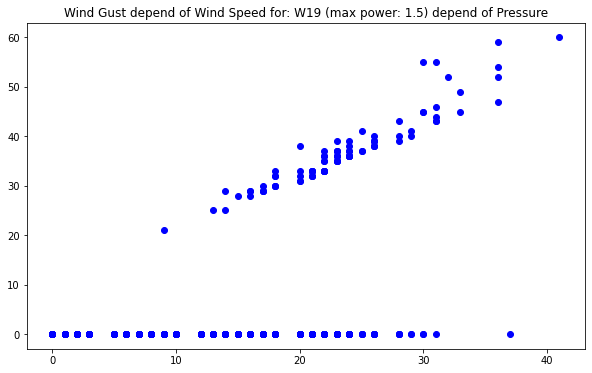

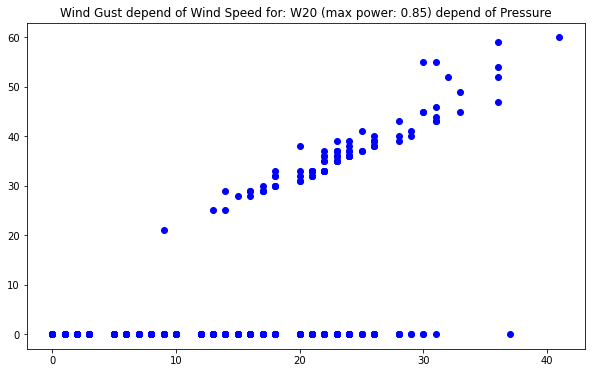

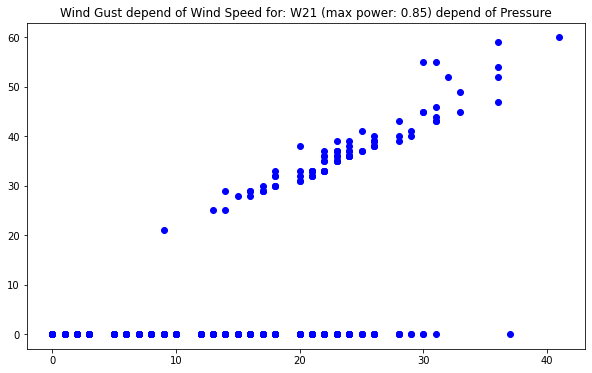

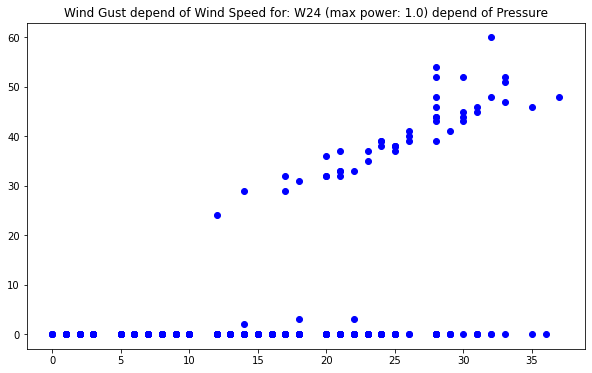

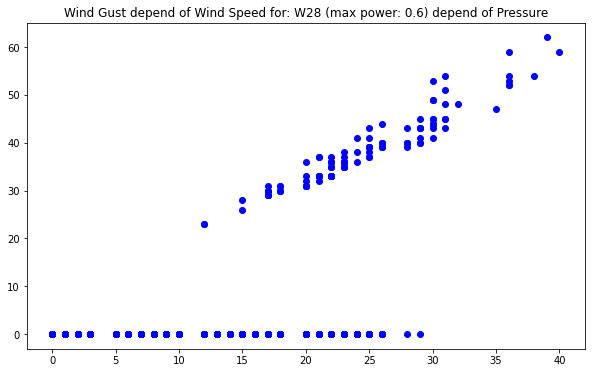

In [52]:
for i in range(0,len(list_of_windfarm)):
  fig, ax = plt.subplots(figsize=(10, 6))
    
  ax.scatter(full_wind_df['Wind Speed'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], full_wind_df['Wind Gust'].loc[full_wind_df['wind_turbine']==list_of_windfarm[i]], 
            marker='o', color = 'b')
    
  ax.set_title(f"Wind Gust depend of Wind Speed for: {list_of_windfarm[i]} (max power: {windfarm['power'][i]}) depend of {num}")
    
  ax

In [53]:
full_wind_df  =  full_wind_df.drop(columns=['Humidity','Pressure' ], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind',
       'Wind Speed', 'Wind Gust', 'Condition', 'wind_turbine', 'power',
       'estimated production per year', 'weather station', 'first coordinate',
       'second coordinate', 'distancefrom the station'],
      dtype='object')

Now let's check out our categorical features

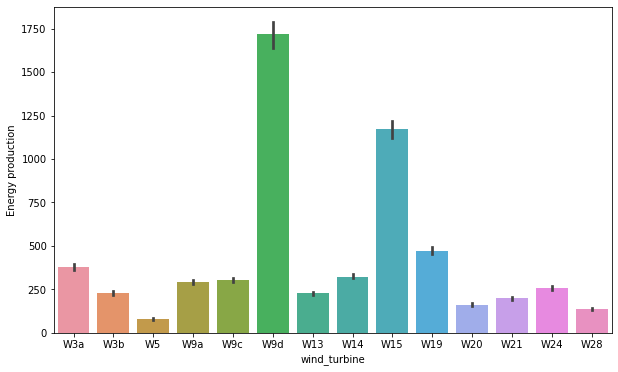

In [54]:
plt.figure(figsize =(10,6))
sns.barplot(x='wind_turbine', y='Energy production', data=full_wind_df)
plt.show()

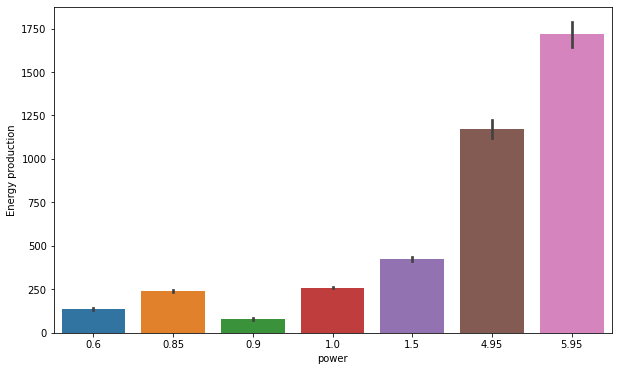

In [55]:
plt.figure(figsize =(10,6))
sns.barplot(x='power', y='Energy production', data=full_wind_df)
plt.show()

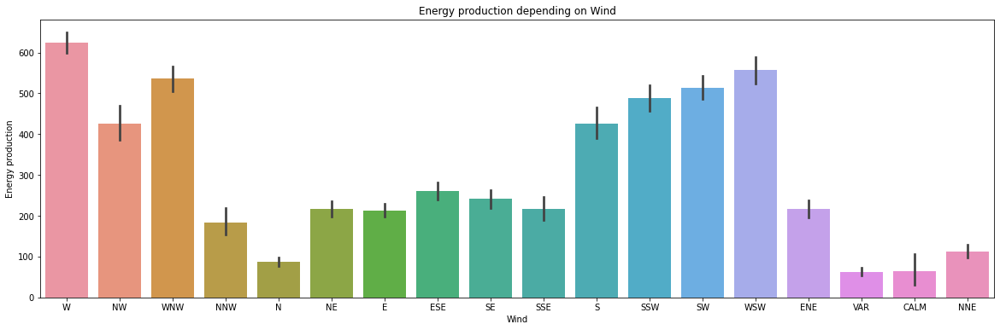

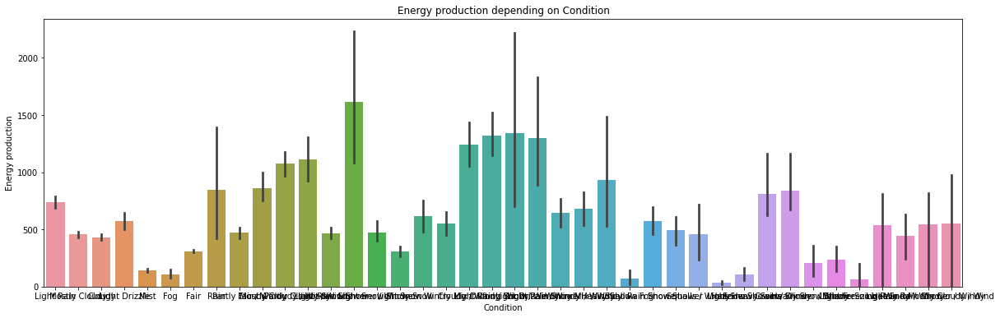

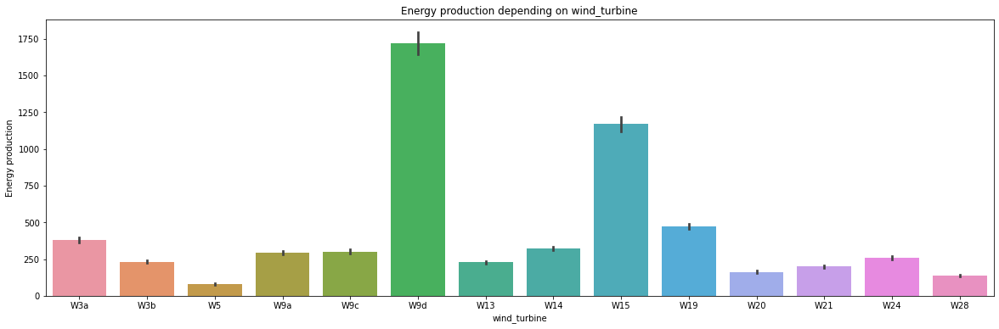

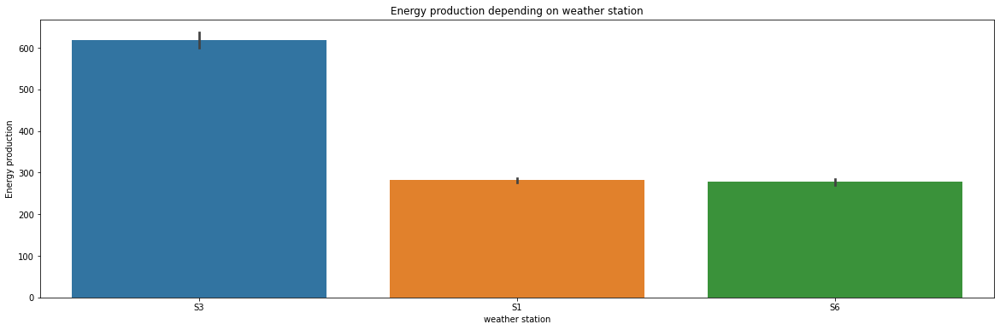

In [56]:
for cat in categorical_features:
  fig, ax = plt.subplots(figsize=(20, 6))
  sns.barplot(x=cat, y='Energy production', data=full_wind_df)
  ax.set_title(f'Energy production depending on {cat}')
  plt.show()

In [58]:
full_wind_df['Condition'].value_counts(normalize=True)

Fair                         0.458916
Mostly Cloudy                0.136646
Cloudy                       0.102182
Light Rain                   0.057260
Mist                         0.050924
Partly Cloudy                0.037547
Mostly Cloudy / Windy        0.023568
Light Drizzle                0.019947
Light Snow                   0.016528
Fog                          0.013007
Fair / Windy                 0.012371
Light Rain / Windy           0.009655
Light Rain Shower / Windy    0.009487
Wintry Mix                   0.008281
Light Rain Shower            0.007342
Cloudy / Windy               0.007141
Partly Cloudy / Windy        0.006370
Light Snow Shower            0.005666
Snow                         0.004459
Wintry Mix / Windy           0.001810
Haze                         0.001341
Light Drizzle / Windy        0.001307
Rain Shower                  0.001073
Light Snow Shower / Windy    0.001006
Snow Shower                  0.000972
Drizzle                      0.000805
Rain        

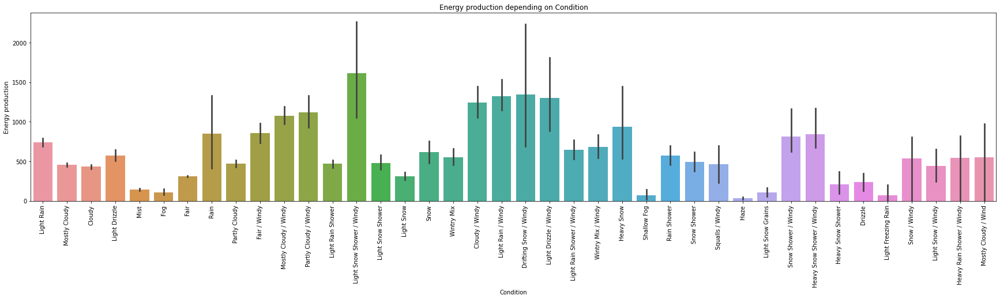

In [59]:
  fig, ax = plt.subplots(figsize=(30, 6))
  sns.barplot(x='Condition', y='Energy production', data=full_wind_df)
  plt.setp(ax.get_xticklabels(), rotation=90)
  ax.set_title(f'Energy production depending on Condition')
  plt.show()

As you can see in the chart above, on windy days the volume of energy produced is higher than on other days. Due to the number of categories and the fact that the information about the occurrence of wind is already included in other features, Condition will be removed

In [60]:
full_wind_df  =  full_wind_df.drop(columns=['Condition'], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind',
       'Wind Speed', 'Wind Gust', 'wind_turbine', 'power',
       'estimated production per year', 'weather station', 'first coordinate',
       'second coordinate', 'distancefrom the station'],
      dtype='object')

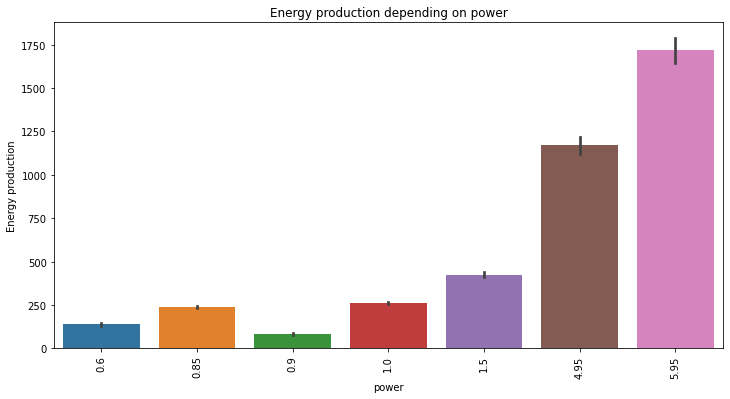

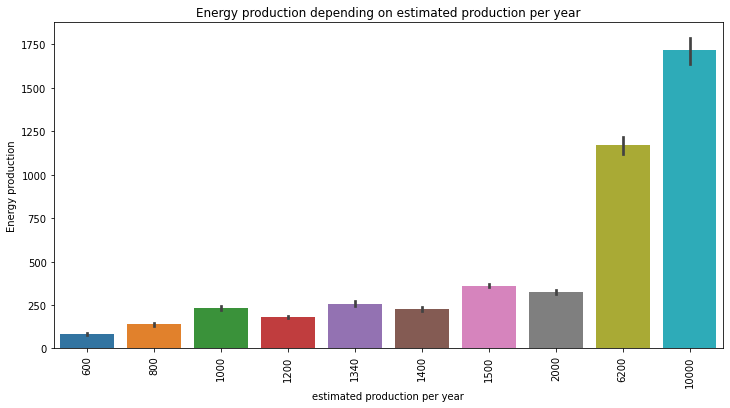

In [61]:
for pr in power_feature:
  fig, ax = plt.subplots(figsize=(12, 6))
  sns.barplot(x=pr, y='Energy production', data=full_wind_df)
  plt.setp(ax.get_xticklabels(), rotation=90)
  ax.set_title(f'Energy production depending on {pr}')
  plt.show()

In [62]:
full_wind_df  =  full_wind_df.drop(columns=['estimated production per year'], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind',
       'Wind Speed', 'Wind Gust', 'wind_turbine', 'power', 'weather station',
       'first coordinate', 'second coordinate', 'distancefrom the station'],
      dtype='object')

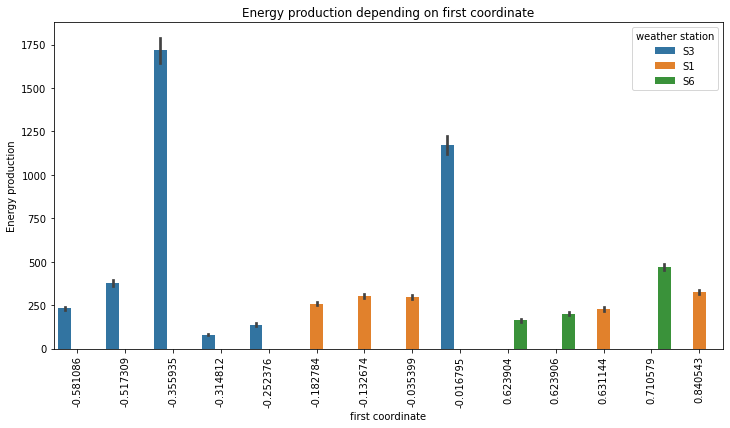

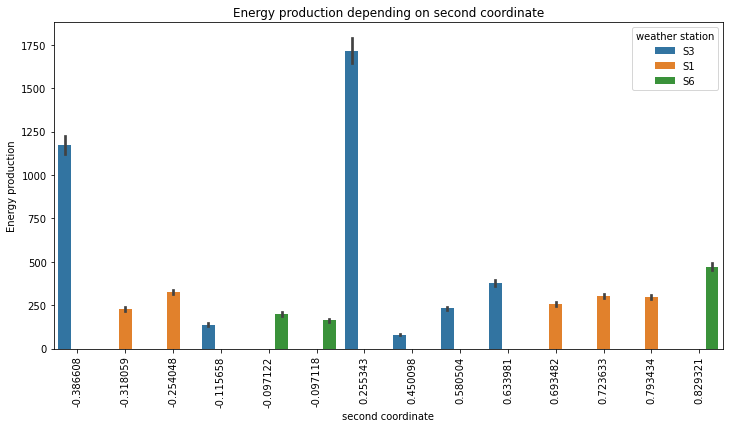

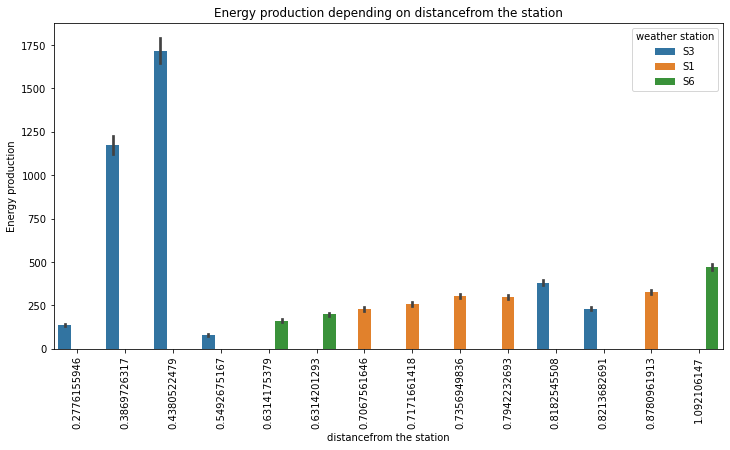

In [63]:
for loc in location_feature:
  fig, ax = plt.subplots(figsize=(12, 6))
  sns.barplot(x=loc, y='Energy production', hue='weather station', data=full_wind_df)
  plt.setp(ax.get_xticklabels(), rotation=90)
  ax.set_title(f'Energy production depending on {loc}')
  plt.show()

.......

In [64]:
wind_local = full_wind_df.loc[:,['Date', 'Energy production', 'power', 'weather station', 'first coordinate', 'second coordinate',
       'distancefrom the station', 'wind_turbine']]
wind_local.sample(10)

,Date,Energy production,power,weather station,first coordinate,second coordinate,distancefrom the station,wind_turbine
16073,2022-02-10 01:00:00,388.302,1.00,S1,0.840543,-0.254048,0.878096,W14
20698,2022-02-22 20:00:00,595.695,1.50,S6,0.710579,0.829321,1.092106,W19
4306,2022-03-31 13:00:00,330.360,1.00,S3,-0.581086,0.580504,0.821368,W3b
2758,2022-01-26 00:00:00,0.000,1.00,S3,-0.581086,0.580504,0.821368,W3b
16935,2022-03-17 23:00:00,286.739,1.00,S1,0.840543,-0.254048,0.878096,W14
5525,2022-02-20 08:00:00,0.000,0.90,S3,-0.314812,0.450098,0.549268,W5
25050,2022-02-24 06:00:00,200.520,0.85,S6,0.623906,-0.097122,0.631420,W21
16707,2022-03-08 11:00:00,0.000,1.00,S1,0.840543,-0.254048,0.878096,W14
2376,2022-01-10 02:00:00,183.408,1.00,S3,-0.581086,0.580504,0.821368,W3b
28922,2022-02-05 16:00:00,354.780,0.60,S3,-0.252376,-0.115658,0.277616,W28


let's check whether the amount of energy production, depending on the location of the wind turbine, is not affected by the amount of power of the wind turbine

for this purpose, we create an auxiliary dataframe where we divide the value of the wind turbine power into three categories: small, medium and large

In [65]:
wind_local['power'].loc[(wind_local['power']<0.9)] = 1
wind_local['power'].loc[(wind_local['power']>0.91)&(wind_local['power']<4)] = 2
wind_local['power'].loc[(wind_local['power']>4.01)] = 3
wind_local.sample(15)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


,Date,Energy production,power,weather station,first coordinate,second coordinate,distancefrom the station,wind_turbine
29019,2022-02-09 17:00:00,265.140,2.0,S3,-0.252376,-0.115658,0.277616,W28
11965,2022-02-18 19:00:00,5622.300,3.0,S3,-0.355935,0.255343,0.438052,W9d
2313,2022-01-07 11:00:00,102.984,2.0,S3,-0.581086,0.580504,0.821368,W3b
23789,2022-01-02 17:00:00,375.228,2.0,S6,0.623906,-0.097122,0.631420,W21
9682,2022-02-13 15:00:00,225.938,2.0,S1,-0.132674,0.723633,0.735695,W9c
1066,2022-02-14 11:00:00,188.100,2.0,S3,-0.517309,0.633981,0.818255,W3a
19549,2022-01-05 23:00:00,658.248,2.0,S6,0.710579,0.829321,1.092106,W19
16971,2022-03-19 11:00:00,127.104,2.0,S1,0.840543,-0.254048,0.878096,W14
18615,2022-02-26 00:00:00,496.800,3.0,S3,-0.016795,-0.386608,0.386973,W15
11181,2022-01-17 03:00:00,5695.200,3.0,S3,-0.355935,0.255343,0.438052,W9d


let's check or the amount of energy production, depending on the location of the wind turbine, is not affected by the amount of power of the wind turbine

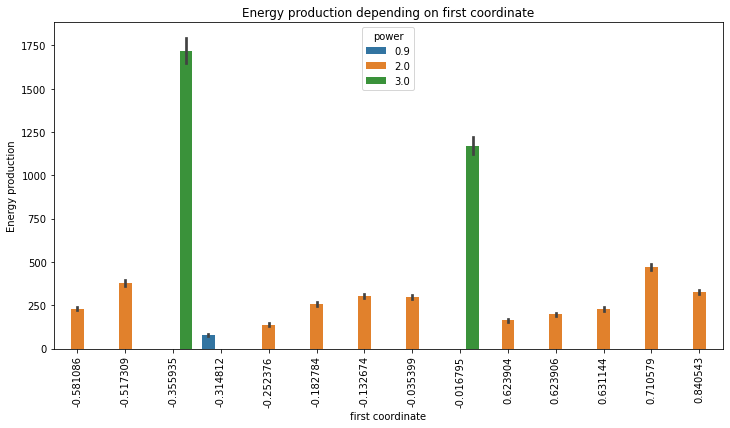

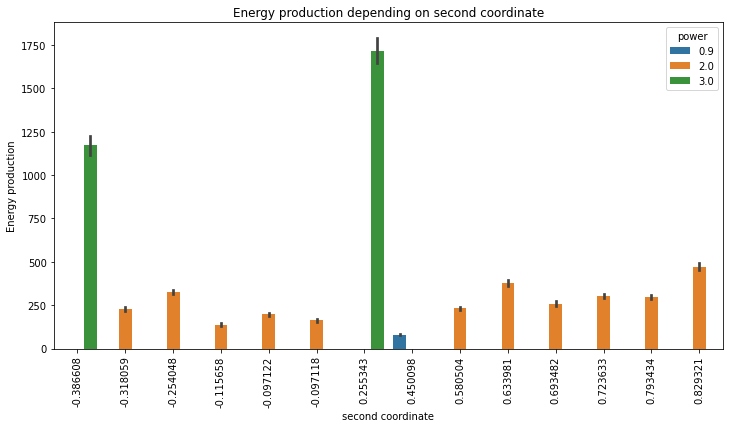

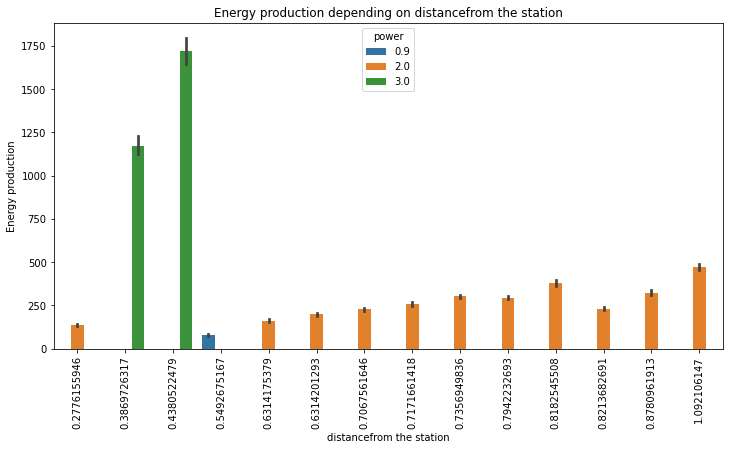

In [66]:
for loc in location_feature:
  fig, ax = plt.subplots(figsize=(12, 6))
  sns.barplot(x=loc, y='Energy production', hue='power', data=wind_local)
  plt.setp(ax.get_xticklabels(), rotation=90)
  ax.set_title(f'Energy production depending on {loc}')
  plt.show()

it can be seen that for each power category of a wind turbine, the amount of generated energy increases with the distance from the weather station
It is possible that the wind speed measured directly at the turbine is slightly higher than at the weather station. Areas ....... are selected as the location of the wind turbine, while the weather stations are located near urbanized areas

however, the coordinates of the distance vector between the wind turbine and the weather station have no effect on the amount of energy produced, so these features will be removed

In [67]:
full_wind_df  =  full_wind_df.drop(columns=['first coordinate', 'second coordinate'], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind',
       'Wind Speed', 'Wind Gust', 'wind_turbine', 'power', 'weather station',
       'distancefrom the station'],
      dtype='object')

We will also remove the information on the id of the wind turbine and the weather station. We don't want this to affect the results

In [68]:
full_wind_df  =  full_wind_df.drop(columns=['wind_turbine', 'weather station'], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind',
       'Wind Speed', 'Wind Gust', 'power', 'distancefrom the station'],
      dtype='object')

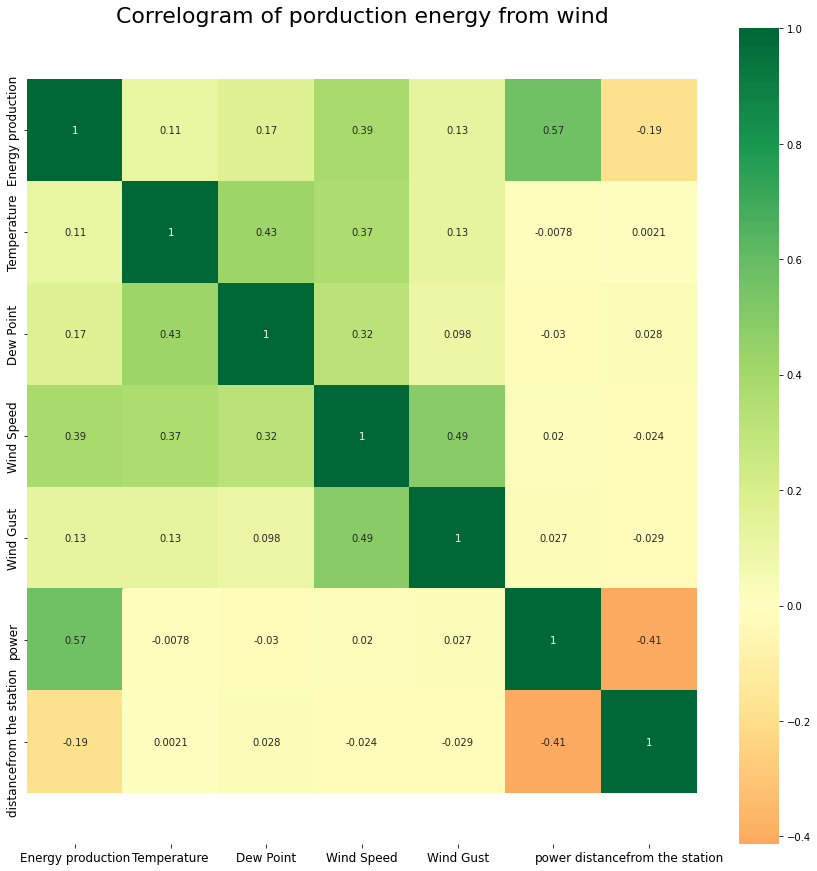

In [70]:
plt.figure(figsize=(15, 15))
ax = sns.heatmap(full_wind_df.corr(), 
                 xticklabels=full_wind_df.corr().columns, 
                 yticklabels=full_wind_df.corr().columns, 
                 cmap='RdYlGn', 
                 center=0, 
                 annot=True)

plt.title('Correlogram of porduction energy from wind', fontsize=22)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Based on the above correlation, we can conclude that we do not have features that carry the same information

We have one categorical feature. Let's convert it to a number

In [71]:
full_wind_df['Wind'].value_counts(normalize=True)

W       0.202655
WSW     0.105133
SW      0.100104
WNW     0.096751
SSW     0.077207
E       0.053974
NW      0.049013
S       0.045761
ESE     0.041302
VAR     0.036810
NE      0.035368
ENE     0.034698
SE      0.029233
N       0.028630
NNW     0.027356
SSE     0.017064
NNE     0.015555
CALM    0.003386
Name: Wind, dtype: float64

In [72]:
full_wind_df[full_wind_df['Wind']=='CALM']

,Date,Energy production,Temperature,Dew Point,Wind,Wind Speed,Wind Gust,power,distancefrom the station
248,2022-01-11 09:00:00,0.0,10.0,5.0,CALM,0.0,0.0,1.5,0.818255
257,2022-01-11 18:00:00,0.0,27.0,25.0,CALM,0.0,0.0,1.5,0.818255
1413,2022-02-28 22:00:00,0.0,25.0,14.0,CALM,0.0,0.0,1.5,0.818255
1443,2022-03-02 04:00:00,0.0,18.0,12.0,CALM,0.0,0.0,1.5,0.818255
1945,2022-03-23 02:00:00,0.0,32.0,19.0,CALM,0.0,0.0,1.5,0.818255
...,...,...,...,...,...,...,...,...,...
30012,2022-03-23 02:00:00,0.0,32.0,19.0,CALM,0.0,0.0,0.6,0.277616
30014,2022-03-23 04:00:00,0.0,28.0,19.0,CALM,0.0,0.0,0.6,0.277616
30015,2022-03-23 05:00:00,0.0,27.0,19.0,CALM,0.0,0.0,0.6,0.277616
30018,2022-03-23 08:00:00,0.0,28.0,21.0,CALM,0.0,0.0,0.6,0.277616


In [73]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29829 entries, 0 to 30225
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Date                      29829 non-null  datetime64[ns]
 1   Energy production         29829 non-null  float64       
 2   Temperature               29829 non-null  float64       
 3   Dew Point                 29829 non-null  float64       
 4   Wind                      29829 non-null  object        
 5   Wind Speed                29829 non-null  float64       
 6   Wind Gust                 29829 non-null  float64       
 7   power                     29829 non-null  float64       
 8   distancefrom the station  29829 non-null  float64       
dtypes: datetime64[ns](1), float64(7), object(1)
memory usage: 3.3+ MB


In [74]:
full_wind_df['Wind'] = full_wind_df['Wind'].astype('str')

In [75]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29829 entries, 0 to 30225
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Date                      29829 non-null  datetime64[ns]
 1   Energy production         29829 non-null  float64       
 2   Temperature               29829 non-null  float64       
 3   Dew Point                 29829 non-null  float64       
 4   Wind                      29829 non-null  object        
 5   Wind Speed                29829 non-null  float64       
 6   Wind Gust                 29829 non-null  float64       
 7   power                     29829 non-null  float64       
 8   distancefrom the station  29829 non-null  float64       
dtypes: datetime64[ns](1), float64(7), object(1)
memory usage: 3.3+ MB


In [76]:
full_wind_df['Wind W'] = [1 if full_wind_df['Wind'][id].find('W')!=-1 else 0 for id in full_wind_df.index]

In [77]:
full_wind_df['Wind N'] = [1 if full_wind_df['Wind'][id].find('N')!=-1 else 0 for id in full_wind_df.index]

In [78]:
full_wind_df['Wind S'] = [1 if full_wind_df['Wind'][id].find('S')!=-1 else 0 for id in full_wind_df.index]

In [79]:
full_wind_df['Wind E'] = [1 if full_wind_df['Wind'][id].find('E')!=-1 else 0 for id in full_wind_df.index]

In [80]:
full_wind_df

,Date,Energy production,Temperature,Dew Point,Wind,Wind Speed,Wind Gust,power,distancefrom the station,Wind W,Wind N,Wind S,Wind E
0,2022-01-01 01:00:00,836.10,52.0,50.0,W,14.0,0.0,1.5,0.818255,1,0,0,0
1,2022-01-01 02:00:00,510.30,50.0,48.0,NW,9.0,0.0,1.5,0.818255,1,1,0,0
2,2022-01-01 03:00:00,622.80,50.0,48.0,NW,12.0,0.0,1.5,0.818255,1,1,0,0
3,2022-01-01 04:00:00,475.74,48.0,46.0,NW,13.0,0.0,1.5,0.818255,1,1,0,0
4,2022-01-01 05:00:00,421.38,48.0,46.0,WNW,10.0,0.0,1.5,0.818255,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30221,2022-03-31 20:00:00,233.28,39.0,9.0,NE,16.0,0.0,0.6,0.277616,0,1,0,1
30222,2022-03-31 21:00:00,267.21,37.0,9.0,NE,15.0,0.0,0.6,0.277616,0,1,0,1
30223,2022-03-31 22:00:00,259.47,37.0,9.0,NE,12.0,0.0,0.6,0.277616,0,1,0,1
30224,2022-03-31 23:00:00,218.16,36.0,10.0,NE,15.0,0.0,0.6,0.277616,0,1,0,1


In [81]:
full_wind_df['Wind VAR'] = [1 if full_wind_df['Wind'][id]=='VAR' else 0 for id in full_wind_df.index]

In [82]:
full_wind_df  =  full_wind_df.drop(columns=['Wind' ], axis=1)
full_wind_df.columns

Index(['Date', 'Energy production', 'Temperature', 'Dew Point', 'Wind Speed',
       'Wind Gust', 'power', 'distancefrom the station', 'Wind W', 'Wind N',
       'Wind S', 'Wind E', 'Wind VAR'],
      dtype='object')

In [83]:
full_wind_df

,Date,Energy production,Temperature,Dew Point,Wind Speed,Wind Gust,power,distancefrom the station,Wind W,Wind N,Wind S,Wind E,Wind VAR
0,2022-01-01 01:00:00,836.10,52.0,50.0,14.0,0.0,1.5,0.818255,1,0,0,0,0
1,2022-01-01 02:00:00,510.30,50.0,48.0,9.0,0.0,1.5,0.818255,1,1,0,0,0
2,2022-01-01 03:00:00,622.80,50.0,48.0,12.0,0.0,1.5,0.818255,1,1,0,0,0
3,2022-01-01 04:00:00,475.74,48.0,46.0,13.0,0.0,1.5,0.818255,1,1,0,0,0
4,2022-01-01 05:00:00,421.38,48.0,46.0,10.0,0.0,1.5,0.818255,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30221,2022-03-31 20:00:00,233.28,39.0,9.0,16.0,0.0,0.6,0.277616,0,1,0,1,0
30222,2022-03-31 21:00:00,267.21,37.0,9.0,15.0,0.0,0.6,0.277616,0,1,0,1,0
30223,2022-03-31 22:00:00,259.47,37.0,9.0,12.0,0.0,0.6,0.277616,0,1,0,1,0
30224,2022-03-31 23:00:00,218.16,36.0,10.0,15.0,0.0,0.6,0.277616,0,1,0,1,0


In [84]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29829 entries, 0 to 30225
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Date                      29829 non-null  datetime64[ns]
 1   Energy production         29829 non-null  float64       
 2   Temperature               29829 non-null  float64       
 3   Dew Point                 29829 non-null  float64       
 4   Wind Speed                29829 non-null  float64       
 5   Wind Gust                 29829 non-null  float64       
 6   power                     29829 non-null  float64       
 7   distancefrom the station  29829 non-null  float64       
 8   Wind W                    29829 non-null  int64         
 9   Wind N                    29829 non-null  int64         
 10  Wind S                    29829 non-null  int64         
 11  Wind E                    29829 non-null  int64         
 12  Wind VAR          

.....

In [85]:
full_wind_df['Date'] = pd.to_numeric(pd.to_datetime(full_wind_df['Date']))

In [86]:
full_wind_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29829 entries, 0 to 30225
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Date                      29829 non-null  int64  
 1   Energy production         29829 non-null  float64
 2   Temperature               29829 non-null  float64
 3   Dew Point                 29829 non-null  float64
 4   Wind Speed                29829 non-null  float64
 5   Wind Gust                 29829 non-null  float64
 6   power                     29829 non-null  float64
 7   distancefrom the station  29829 non-null  float64
 8   Wind W                    29829 non-null  int64  
 9   Wind N                    29829 non-null  int64  
 10  Wind S                    29829 non-null  int64  
 11  Wind E                    29829 non-null  int64  
 12  Wind VAR                  29829 non-null  int64  
dtypes: float64(7), int64(6)
memory usage: 4.2 MB


#MODELOWANIE

In [87]:
pip install fast_ml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 42 kB 858 kB/s 


In [88]:
from sklearn.model_selection import train_test_split 
from fast_ml.model_development import train_valid_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
import xgboost as xgb
from xgboost import XGBRegressor


from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline 
from sklearn.model_selection import GridSearchCV 
from sklearn.model_selection import cross_val_score, KFold

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error 
from math import sqrt

import joblib
from joblib import dump

## Separation of the target and division into sets: training, validation and test

In [89]:
X = full_wind_df.drop(['Energy production'], axis=1)
y = full_wind_df['Energy production']

In [90]:
X_train, y_train, X_valid, y_valid, X_test, y_test = train_valid_test_split(full_wind_df, target = 'Energy production',
                                                                            train_size=0.8, valid_size=0.1, test_size=0.1)

In [91]:
print(f'X.shape: {X.shape}, y.shape: {y.shape}')
print()
print(f'X_train.shape: {X_train.shape}, y_train.shape: {y_train.shape}')
print()
print(f'X_valid.shape: {X_valid.shape}, y_valid.shape: {y_valid.shape}')
print()
print(f'X_test.shape: {X_test.shape}, y_test.shape: {y_test.shape}')

X.shape: (29829, 12), y.shape: (29829,)

X_train.shape: (23863, 12), y_train.shape: (23863,)

X_valid.shape: (2983, 12), y_valid.shape: (2983,)

X_test.shape: (2983, 12), y_test.shape: (2983,)


### Standaryzacja

In [92]:
scaler = StandardScaler().fit(X_train)
dump(scaler, 'std_scaler.bin', compress=True)
X_train_sc = scaler.transform(X_train)
X_valid_sc = scaler.transform(X_valid)
X_test_sc = scaler.transform(X_test)

### Function for evaluation and visuaization model

In [93]:
metrics_dataframe = pd.DataFrame(columns = ['Model', 'R^2', 'MAE - train', 'MAE - valid'])
def metrics_funcion(name, y, y_predict, y_valid, y_predict_valid):
  global metrics_dataframe
  r2_metric =  r2_score(y, y_predict)
 
  mae_metric = mean_absolute_error(y, y_predict)
  mae_metric_valid = mean_absolute_error(y_valid, y_predict_valid)

  # mse_metric = mean_squared_error(y, y_predict)
  # mse_metric_valid = mean_squared_error(y_valid, y_predict_valid)
  
  # rmse_metric = sqrt(mse_metric)
  # rmse_metric_valid = sqrt(mse_metric_valid)
  

  metrics_dataframe = metrics_dataframe.append({'Model': name,
                                                'R^2': round(r2_metric,2),
                                                'MAE - train': round(mae_metric,2),
                                                'MAE - valid': round(mae_metric_valid,2)},
                                                 ignore_index=True)
  return metrics_dataframe

In [94]:
def vizualization_of_errors(y, y_predict):
  plt.scatter(x= y_predict, y = y, alpha=0.25)
  xmin, xmax = y.min(), y.max()
  x_line = np.linspace(xmin, xmax, 10)
  y_line = x_line
#oczekiwana linia pędu
  plt.plot(x_line, y_line, 'r--')
  plt.xlabel('Prediction')
  plt.ylabel('True value')
  plt.title('Plot of predicted values versustrue values')
  plt.show()
  errors = y_predict - y
  plt.scatter(x= y, y= errors, alpha= 0.25)
  plt.axhline(0, color = 'r', linestyle='--')
  plt.xlabel('True value')
  plt.ylabel('Residuals')
  plt.title('Plot of residuals')
  plt.show()
  print(f'Error means: {errors.mean()}')
  plt.hist(errors, bins=20)
  plt.axvline(errors.mean(), color ='k', linestyle='dashed', linewidth=1)
  plt.title('Histogram of residuals')
  plt.show()

## Regression Model

In [95]:
lr_model = LinearRegression() 
lr_model.fit(X_train_sc, y_train) 
lr_model.intercept_
y_predict_train = lr_model.predict(X_train_sc)
y_predict_val= lr_model.predict(X_valid_sc)

In [96]:
metrics_funcion('Linear Regresion', y_train, y_predict_train, y_valid, y_predict_val)


,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.0


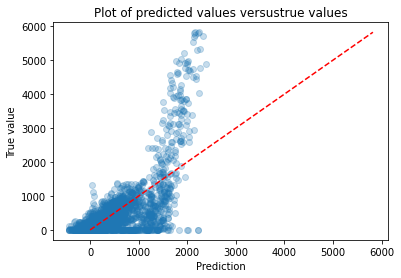

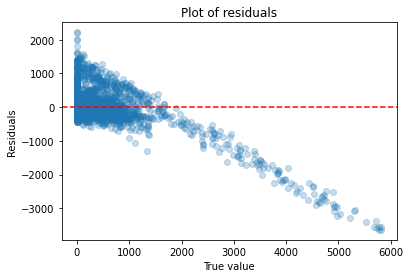

Error means: -7.034738327130413


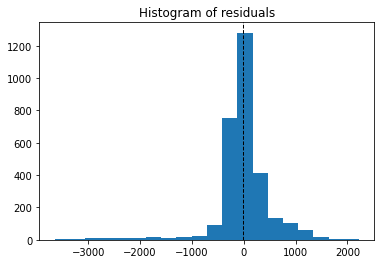

In [97]:
vizualization_of_errors(y_valid, y_predict_val)

## Polynomial Regresion Model

In [98]:
poly = PolynomialFeatures(degree=2) 
X_train_poly = poly.fit_transform(X_train_sc)
pr_model = LinearRegression() 
pr_model.fit(X_train_poly, y_train) 
pr_model.intercept_
y_predict_train = pr_model.predict(X_train_poly)
X_valid_poly = poly.transform(X_valid_sc)
y_predict_valid = pr_model.predict(X_valid_poly)

In [99]:
metrics_funcion('Polynomial Regresion degree=2', y_train, y_predict_train,y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.0
1,Polynomial Regresion degree=2,0.72,224.21,225.4


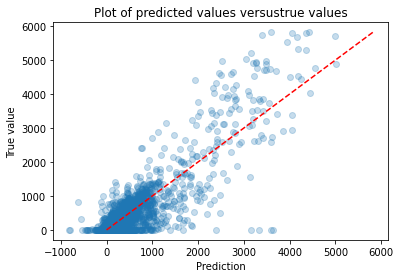

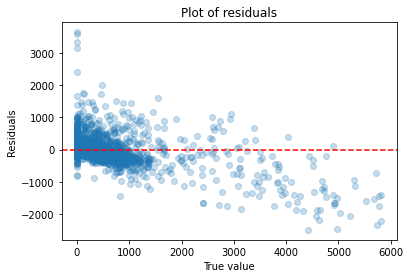

Error means: 2.057396732525982


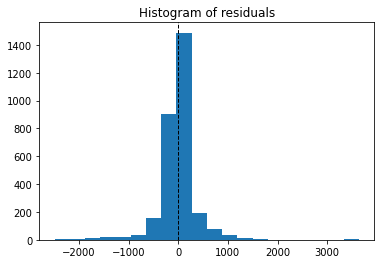

In [100]:
vizualization_of_errors(y_valid, y_predict_valid)

In [101]:
joblib.dump(pr_model, 'wind_polynomial_model.sav')

['wind_polynomial_model.sav']

In [103]:
polynomial_regression_pipeline = make_pipeline(PolynomialFeatures(),
                                               LinearRegression())

params = {'polynomialfeatures__degree':[1,2,3,4,5]}
polynomial_regression_gridsearch = GridSearchCV(polynomial_regression_pipeline, 
                                                params, 
                                                scoring = 'neg_mean_absolute_error', 
                                                cv = 10, 
                                                verbose= 10)
                                                #n_jobs=-1)
polynomial_regression_gridsearch.fit(X_train_sc, y_train)
print('\nBest hypermarameter: ', polynomial_regression_gridsearch.best_params_)
polynomial_model = polynomial_regression_gridsearch.best_estimator_

Fitting 10 folds for each of 5 candidates, totalling 50 fits
[CV 1/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 1/10; 1/5] END polynomialfeatures__degree=1;, score=-320.756 total time=   0.0s
[CV 2/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 2/10; 1/5] END polynomialfeatures__degree=1;, score=-311.178 total time=   0.0s
[CV 3/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 3/10; 1/5] END polynomialfeatures__degree=1;, score=-302.051 total time=   0.0s
[CV 4/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 4/10; 1/5] END polynomialfeatures__degree=1;, score=-292.715 total time=   0.0s
[CV 5/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 5/10; 1/5] END polynomialfeatures__degree=1;, score=-312.588 total time=   0.0s
[CV 6/10; 1/5] START polynomialfeatures__degree=1...............................
[CV 6/10; 1/5] END polynomialfeat

Jako najlpszy stopień wielomianu wybrany został stopiń 2. Jest on taki sam jak ww wcześniejszym modelu więc wynik powiniem być taki sam. 

In [104]:
y_predict = polynomial_model.predict(X_train_sc)
y_predict_valid = polynomial_model.predict(X_valid_sc)


In [ ]:
vizualization_of_errors(y_valid, y_predict_valid)

In [105]:
metrics_funcion(f'Polynomial Regresion best degree=2', y_train, y_predict ,y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.0
1,Polynomial Regresion degree=2,0.72,224.21,225.4
2,Polynomial Regresion best degree=2,0.72,224.21,225.4


In [ ]:
# joblib.dump(polynomial_model, 'wind_polynomial_gs_model.sav')

## DecisionTreeRegressor

In [106]:
model_tree = DecisionTreeRegressor()

params = {'max_depth': [1, 2, 3, 4, 5],
          'min_samples_leaf': [2,3,5,10,15,20]}

model_tree_gridsearch = GridSearchCV(model_tree, 
                                                params,
                                                scoring='neg_mean_absolute_error',
                                                cv=10,
                                                verbose=10)

model_tree_gridsearch.fit(X_train_sc, y_train)
print('\nBest hyperparameter:', model_tree_gridsearch.best_params_)

model_tree_GS = model_tree_gridsearch.best_estimator_

Fitting 10 folds for each of 30 candidates, totalling 300 fits
[CV 1/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 1/10; 1/30] END max_depth=1, min_samples_leaf=2;, score=-377.211 total time=   0.0s
[CV 2/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 2/10; 1/30] END max_depth=1, min_samples_leaf=2;, score=-378.420 total time=   0.0s
[CV 3/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 3/10; 1/30] END max_depth=1, min_samples_leaf=2;, score=-357.862 total time=   0.0s
[CV 4/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 4/10; 1/30] END max_depth=1, min_samples_leaf=2;, score=-350.450 total time=   0.0s
[CV 5/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 5/10; 1/30] END max_depth=1, min_samples_leaf=2;, score=-372.660 total time=   0.0s
[CV 6/10; 1/30] START max_depth=1, min_samples_leaf=2...........................
[CV 6/10; 1

In [107]:
y_predict = model_tree_GS.predict(X_train_sc)
y_predict_valid = model_tree_GS.predict(X_valid_sc)

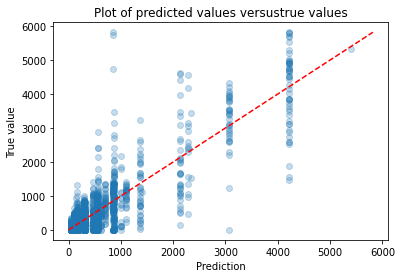

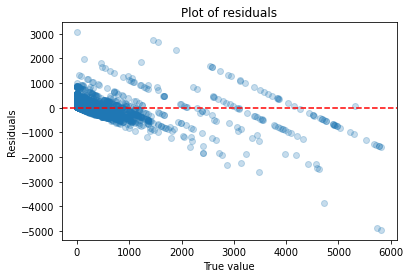

Error means: 1.5439877249197633


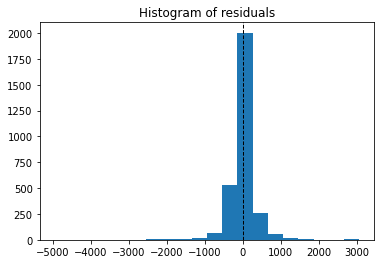

In [108]:
vizualization_of_errors(y_valid, y_predict_valid)

In [109]:
metrics_funcion(f'DecisionTree max_depth=5, min_sample_leaf=2', y_train, y_predict ,y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.00
1,Polynomial Regresion degree=2,0.72,224.21,225.40
2,Polynomial Regresion best degree=2,0.72,224.21,225.40
3,"DecisionTree max_depth=5, min_sample_leaf=2",0.77,206.93,213.08


In [110]:
joblib.dump(model_tree_GS, 'wind_tree_gs_model.sav')

['wind_tree_gs_model.sav']

The best max_depth is 5. Let's check if we get a better result for Max_depth 4 and 6

In [111]:
model_tree2 = DecisionTreeRegressor()

params = {'max_depth': [4,5,6,10,15],
          'min_samples_leaf': [2,3,4,5,10,15,20]}

model_tree2_gridsearch = GridSearchCV(model_tree, 
                                                params,
                                                scoring='neg_mean_absolute_error',
                                                cv=10,
                                                verbose=10)

model_tree2_gridsearch.fit(X_train_sc, y_train)
print('\nBest hyperparameter:', model_tree_gridsearch.best_params_)

model_tree_GS2 = model_tree_gridsearch.best_estimator_

Fitting 10 folds for each of 35 candidates, totalling 350 fits
[CV 1/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 1/10; 1/35] END max_depth=4, min_samples_leaf=2;, score=-232.604 total time=   0.0s
[CV 2/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 2/10; 1/35] END max_depth=4, min_samples_leaf=2;, score=-224.861 total time=   0.0s
[CV 3/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 3/10; 1/35] END max_depth=4, min_samples_leaf=2;, score=-223.832 total time=   0.0s
[CV 4/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 4/10; 1/35] END max_depth=4, min_samples_leaf=2;, score=-217.239 total time=   0.0s
[CV 5/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 5/10; 1/35] END max_depth=4, min_samples_leaf=2;, score=-217.394 total time=   0.0s
[CV 6/10; 1/35] START max_depth=4, min_samples_leaf=2...........................
[CV 6/10; 1

Result is the same

## XGBRegressor

In [112]:
xgb_model = XGBRegressor()

In [113]:
xgb_model.fit(X_train_sc, y_train)

[15:32:56] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor()

In [114]:
y_predict = xgb_model.predict(X_train_sc)
y_predict_valid = xgb_model.predict(X_valid_sc)

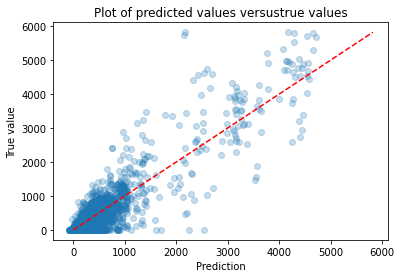

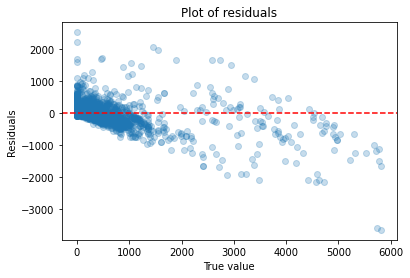

Error means: 0.062326149903727035


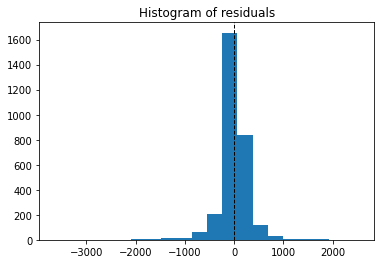

In [115]:
vizualization_of_errors(y_valid, y_predict_valid)

In [116]:
metrics_funcion(f'XGBRegressor', y_train, y_predict, y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.00
1,Polynomial Regresion degree=2,0.72,224.21,225.40
2,Polynomial Regresion best degree=2,0.72,224.21,225.40
3,"DecisionTree max_depth=5, min_sample_leaf=2",0.77,206.93,213.08
4,XGBRegressor,0.82,179.37,183.88


In [117]:
joblib.dump(model_tree_GS, 'wind_xgb_model.sav')

['wind_xgb_model.sav']

In [118]:
xgb_model = XGBRegressor(objective='reg:linear')

params = {'n_estimators': [5,10,20,50],
          'max_depth': [2,3,4,5,6, 10],
          'max_leaves': [2,3,4,5,10,15,20],
          'learning_rate': [0.01, 0.02, 0.05, 0.1]}
xgb_gridsearch = GridSearchCV(xgb_model, 
                              params, 
                              scoring = 'neg_mean_absolute_error', 
                              cv = 10, 
                              verbose= 10)
                              #n_jobs=-1)
xgb_gridsearch.fit(X_train_sc, y_train)
print('\nBest hypermarameter: ', xgb_gridsearch.best_params_)
xgb_model = xgb_gridsearch.best_estimator_ 

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[16:12:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 5/10; 506/672] END learning_rate=0.1, max_depth=2, max_leaves=2, n_estimators=10;, score=-271.440 total time=   0.1s
[CV 6/10; 506/672] START learning_rate=0.1, max_depth=2, max_leaves=2, n_estimators=10
[16:12:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 6/10; 506/672] END learning_rate=0.1, max_depth=2, max_leaves=2, n_estimators=10;, score=-296.237 total time=   0.1s
[CV 7/10; 506/672] START learning_rate=0.1, max_depth=2, max_leaves=2, n_estimators=10
[16:12:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 7/10; 506/672] END learning_rate=0.1, max_depth=2, max_leaves=2, n_estimators=10;, score=-266.062 total time=   0.1s
[CV 8/10; 506/672

In [119]:
y_predict = xgb_model.predict(X_train_sc)
y_predict_valid = xgb_model.predict(X_valid_sc)

In [120]:
metrics_funcion(f'XGBRegressor_GS', y_train, y_predict, y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.00
1,Polynomial Regresion degree=2,0.72,224.21,225.40
2,Polynomial Regresion best degree=2,0.72,224.21,225.40
3,"DecisionTree max_depth=5, min_sample_leaf=2",0.77,206.93,213.08
4,XGBRegressor,0.82,179.37,183.88
5,XGBRegressor_GS,0.97,77.60,124.46


In [121]:
xgb_model.save_model('wind_xgb_gs_model.json')

In [ ]:
STOP

In [122]:
xgb_model = XGBRegressor(objective='reg:squarederror')

params = {'n_estimators': [5,10,20,50,75,100],
          'max_depth': [8,9,10,12],
          'max_leaves': [2,3,4,5,10,15,20],
          'learning_rate': [0.02, 0.08, 0.1]}
xgb_gridsearch = GridSearchCV(xgb_model, 
                              params, 
                              scoring = 'neg_mean_absolute_error', 
                              cv = 10, 
                              verbose= 10)
                              #n_jobs=-1)
xgb_gridsearch.fit(X_train_sc, y_train)
print('\nBest hypermarameter: ', xgb_gridsearch.best_params_)
xgb_model = xgb_gridsearch.best_estimator_

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[CV 2/10; 255/504] START learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20
[CV 2/10; 255/504] END learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20;, score=-173.689 total time=   0.9s
[CV 3/10; 255/504] START learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20
[CV 3/10; 255/504] END learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20;, score=-169.332 total time=   0.9s
[CV 4/10; 255/504] START learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20
[CV 4/10; 255/504] END learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20;, score=-160.720 total time=   0.9s
[CV 5/10; 255/504] START learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20
[CV 5/10; 255/504] END learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=20;, score=-161.535 total time=   0.9s
[CV 6/10; 255/504] START learning_rate=0.08, max_depth=10, max_leaves=2, n_estimators=2

In [123]:
y_predict = xgb_model.predict(X_train_sc)
y_predict_valid = xgb_model.predict(X_valid_sc)

In [124]:
metrics_funcion(f'XGBRegressor_GS2', y_train, y_predict, y_valid, y_predict_valid)

,Model,R^2,MAE - train,MAE - valid
0,Linear Regresion,0.48,308.42,312.00
1,Polynomial Regresion degree=2,0.72,224.21,225.40
2,Polynomial Regresion best degree=2,0.72,224.21,225.40
3,"DecisionTree max_depth=5, min_sample_leaf=2",0.77,206.93,213.08
4,XGBRegressor,0.82,179.37,183.88
5,XGBRegressor_GS,0.97,77.60,124.46
6,XGBRegressor_GS2,1.00,33.08,110.44


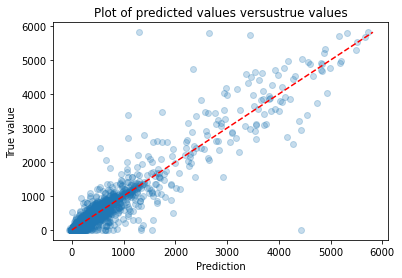

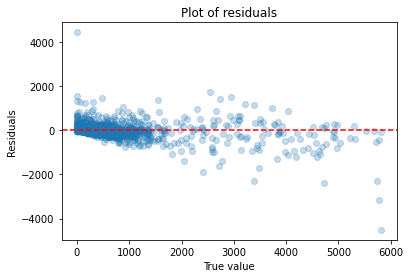

Error means: 0.6099199949076548


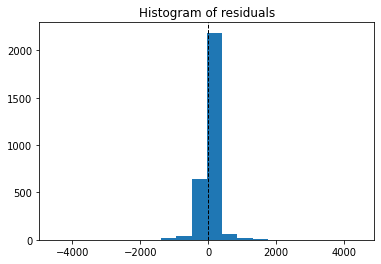

In [125]:
vizualization_of_errors(y_valid, y_predict_valid)

In [126]:
xgb_model.save_model('wind_xgb_gs2_model.json')